<a href="https://colab.research.google.com/github/shreyashrawat/SatelliteImageConvertor/blob/master/SatelliteImageConvertor.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [1]:
!wget http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz

--2020-05-21 01:40:28--  http://efrosgans.eecs.berkeley.edu/pix2pix/datasets/maps.tar.gz
Resolving efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)... 128.32.189.73
Connecting to efrosgans.eecs.berkeley.edu (efrosgans.eecs.berkeley.edu)|128.32.189.73|:80... connected.
HTTP request sent, awaiting response... 200 OK
Length: 250242400 (239M) [application/x-gzip]
Saving to: ‘maps.tar.gz’

maps.tar.gz         100%[===================>] 238.65M  3.40MB/s    in 3m 26s  

2020-05-21 01:43:55 (1.16 MB/s) - ‘maps.tar.gz’ saved [250242400/250242400]



In [2]:
!tar -xvf maps.tar.gz


maps/
maps/train/
maps/train/1.jpg
maps/train/10.jpg
maps/train/100.jpg
maps/train/1000.jpg
maps/train/1001.jpg
maps/train/1002.jpg
maps/train/1003.jpg
maps/train/1004.jpg
maps/train/1005.jpg
maps/train/1006.jpg
maps/train/1007.jpg
maps/train/1008.jpg
maps/train/1009.jpg
maps/train/101.jpg
maps/train/1010.jpg
maps/train/1011.jpg
maps/train/1012.jpg
maps/train/1013.jpg
maps/train/1014.jpg
maps/train/1015.jpg
maps/train/530.jpg
maps/train/531.jpg
maps/train/532.jpg
maps/train/533.jpg
maps/train/534.jpg
maps/train/535.jpg
maps/train/536.jpg
maps/train/537.jpg
maps/train/538.jpg
maps/train/539.jpg
maps/train/54.jpg
maps/train/540.jpg
maps/train/541.jpg
maps/train/542.jpg
maps/train/543.jpg
maps/train/544.jpg
maps/train/545.jpg
maps/train/546.jpg
maps/train/547.jpg
maps/train/548.jpg
maps/train/549.jpg
maps/train/55.jpg
maps/train/550.jpg
maps/train/551.jpg
maps/train/552.jpg
maps/train/553.jpg
maps/train/554.jpg
maps/train/555.jpg
maps/train/556.jpg
maps/train/557.jpg
maps/train/558.jpg
ma

In [0]:
import keras 
import os
import numpy as np
import matplotlib.pyplot as plt
import matplotlib.image as mpimg

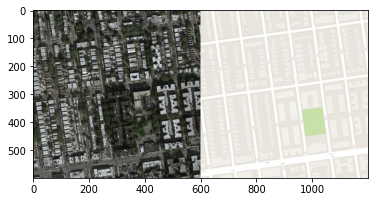

In [4]:
plt.imshow(mpimg.imread("maps/train/" + '579.jpg'))

In [0]:
from keras.preprocessing.image import load_img, img_to_array

In [0]:
def load_images(path, size = (256,512)):
  src_imgs, tar_imgs = [], []
  for filename in os.listdir(path):
    pixels = load_img(path + filename, target_size = size)
    pixels = img_to_array(pixels)
    p1 = (pixels[:,:256] - 127.5)/127.5
    src_imgs.append(p1)
    p2 = (pixels[:,256:] - 127.5)/127.5
    tar_imgs.append(p2)
  return [np.asarray(src_imgs), np.asarray(tar_imgs)]

In [0]:
dataset= load_images("maps/train/")

In [8]:
plt.imshow(data[1][1].astype("uint8"))

NameError: ignored

NameError: ignored

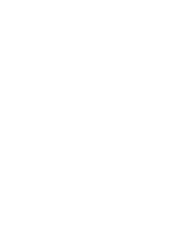

In [9]:
plt.figure(figsize = (10,4))
for i in range(3):
  plt.subplot(1,3,i+1)
  plt.axis("off")
  plt.imshow(src_images[i].astype("uint8"))
plt.show()
plt.figure(figsize = (10,4))

for i in range(3):
  plt.subplot(1,3,i+1)
  plt.axis("off")
  plt.imshow(tar_images[i].astype("uint8"))
plt.show()

In [12]:
from keras.layers import Dense, Input, Conv2D, BatchNormalization, LeakyReLU
from keras.models import Model

Using TensorFlow backend.


In [0]:
def discriminator(input_shape):
  in_src_img = Input(shape = input_shape)
  in_target_img = Input(shape = input_shape)

  merge = keras.layers.Concatenate()([in_src_img, in_target_img])

  d = Conv2D(64, 4, strides = (2,2), padding="same")(merge)
  d = LeakyReLU(0.2)(d)

  d = Conv2D(128, 4, strides = (2,2), padding = "same")(d)
  d = BatchNormalization()(d)
  d = LeakyReLU(0.2)(d)

  d = Conv2D(256, 4, strides = (2,2), padding = "same")(d)
  d = BatchNormalization()(d)
  d = LeakyReLU(0.2)(d)

  d = Conv2D(512, 4, strides = (2,2), padding = "same")(d)
  d = BatchNormalization()(d)
  d = LeakyReLU(0.2)(d)

  out = Conv2D(1, (4,4), activation = "sigmoid", padding = "same")(d)
  model = Model([in_src_img, in_target_img], out)

  model.compile(optimizer =  keras.optimizers.Adam(0.0002, beta_1= 0.5), loss = "binary_crossentropy")
  return model

In [0]:
d_model = discriminator((256,256,3))

In [23]:
d_model.summary()

Model: "model_1"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_3 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
input_4 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
concatenate_1 (Concatenate)     (None, 256, 256, 6)  0           input_3[0][0]                    
                                                                 input_4[0][0]                    
__________________________________________________________________________________________________
conv2d_1 (Conv2D)               (None, 128, 128, 64) 6208        concatenate_1[0][0]        

In [0]:
def encoder_block(layer_in, n_filters, batch_norm = True):
  g = Conv2D(n_filters, (4,4), strides = (2,2), padding = "same")(layer_in)
  if batch_norm:
    g = BatchNormalization()(g)
  g = LeakyReLU(0.2)(g)
  return g



In [0]:
def decoder_block(layer_in,skip_in, n_filters, dropout = True):
  g = keras.layers.Conv2DTranspose(n_filters, (4,4), strides = (2,2), padding = "same")(layer_in)
  g = BatchNormalization()(g)
  if dropout:
    g = keras.layers.Dropout(0.5)(g)
  g = keras.layers.Concatenate()([g,skip_in])
  g = keras.layers.Activation("relu")(g)
  return g

In [0]:
def generator(inp_shape = (256,256,3)):

  i = Input(shape = inp_shape)

  e1 = encoder_block(i, 64, batch_norm = False)
  e2 = encoder_block(e1,128)
  e3 = encoder_block(e2, 256)
  e4 = encoder_block(e3, 512)
  e5 = encoder_block(e4, 512)
  e6 = encoder_block(e5, 512)
  e7 = encoder_block(e6, 512)

  b = Conv2D(512, (4,4), strides = (2,2), padding="same")(e7)
  b = keras.layers.Activation("relu")(b)

  d1 = decoder_block(b, e7, 512)
  d2 = decoder_block(d1, e6, 512)
  d3 = decoder_block(d2, e5, 512)
  d4 = decoder_block(d3, e4, 512, dropout=False)
  d5 = decoder_block(d4, e3, 256, dropout = False)
  d6 = decoder_block(d5, e2, 128, dropout = False)
  d7 = decoder_block(d6, e1, 64, dropout = False)

  g = keras.layers.Conv2DTranspose(3, (4,4), strides = (2,2), padding="same")(d7)
  out = keras.layers.Activation("tanh")(g)
  model = Model(i, out)
  return model

In [0]:

g_model = generator()

In [28]:
g_model.summary()

Model: "model_2"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_5 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
conv2d_6 (Conv2D)               (None, 128, 128, 64) 3136        input_5[0][0]                    
__________________________________________________________________________________________________
leaky_re_lu_5 (LeakyReLU)       (None, 128, 128, 64) 0           conv2d_6[0][0]                   
__________________________________________________________________________________________________
conv2d_7 (Conv2D)               (None, 64, 64, 128)  131200      leaky_re_lu_5[0][0]              
____________________________________________________________________________________________

In [0]:
def gan(d_model, g_model, image_shape):
  d_model.trainable = False
  in_src = Input(shape = image_shape)
  gen_out = g_model(in_src)
  d_out = d_model([in_src, gen_out])
  model = Model(in_src, [d_out, gen_out])
  model.compile(keras.optimizers.Adam(0.0002, beta_1=0.5), loss = ["binary_crossentropy", "mae"])
  return model

In [0]:
gan_model = gan(d_model, g_model, (256,256,3))

In [31]:
gan_model.summary()

Model: "model_3"
__________________________________________________________________________________________________
Layer (type)                    Output Shape         Param #     Connected to                     
input_6 (InputLayer)            (None, 256, 256, 3)  0                                            
__________________________________________________________________________________________________
model_2 (Model)                 (None, 256, 256, 3)  54429315    input_6[0][0]                    
__________________________________________________________________________________________________
model_1 (Model)                 (None, 16, 16, 1)    2771393     input_6[0][0]                    
                                                                 model_2[1][0]                    
Total params: 57,200,708
Trainable params: 54,419,459
Non-trainable params: 2,781,249
__________________________________________________________________________________________________


In [0]:
def load_real_samples(filename):
  data = np.load(filename)
  X1, X2 = data['arr_0'], data['arr_1']
  X1 = (X1 -127.5)/127.5
  X2 = (X2 - 127.5)/127.5
  return [X1, X2]

In [0]:
def generate_real_samples(dataset, n_samples, patch_size):
  X1, X2 = dataset
  ind = np.random.randint(0, X1.shape[0], n_samples)
  X1, X2 = X1[ind], X2[ind]
  y = np.ones((n_samples, patch_size, patch_size, 1))
  return [X1, X2], y

In [0]:
def generate_fake_samples(g_model, samples, patch_size ):
  X = g_model.predict(samples)
  y = np.zeros((len(X), patch_size, patch_size, 1))
  return X,y

In [0]:
def summarize_performance(dataset,g_model, n_samples = 3):
  [X_realA, X_realB], y_real = generate_real_samples(dataset, n_samples, 1)
  X_fakeB, _ = generate_fake_samples(g_model, X_realA, 1)
  X_realA = (X_realA + 1)/2.0
  X_realB = (X_realB + 1)/2.0
  X_fakeB = (X_fakeB + 1)/2.0
  g_model.save("gen_model.h5")
  plt.figure(figsize = (10,3))
  for i in range(n_samples):
    plt.subplot(1, n_samples, i+1)
    plt.axis("off")
    plt.imshow(X_realA[i])
  plt.show()
  plt.figure(figsize = (10,3))
  for i in range(n_samples):
    plt.subplot(1, n_samples, i+1)
    plt.axis("off")
    plt.imshow(X_fakeB[i])
  plt.show()
  plt.figure(figsize = (10,3))
  for i in range(n_samples):
    plt.subplot(1, n_samples, i+1)
    plt.axis("off")
    plt.imshow(X_realB[i])
  plt.show()


In [0]:
def train(d_model, g_model, gan_model, dataset, epochs = 50, batch_size = 1):
  n_patch = d_model.output_shape[1]
  trainA, trainB = dataset
  batch_per_epoch = int(len(trainA)/batch_size)
  n_steps = batch_per_epoch * epochs
  for i in range(n_steps):
    [X_realA, X_realB], y_realA = generate_real_samples(dataset, batch_size, n_patch)
    X_fakeB, y_fakeB = generate_fake_samples(g_model, X_realA, n_patch)
    d_loss1 = d_model.train_on_batch([X_realA, X_realB], y_realA)
    d_loss2 = d_model.train_on_batch([X_realA, X_fakeB], y_fakeB)
    g_loss, _, _ = gan_model.train_on_batch(X_realA, [y_realA, X_realB])
    print('>%d, d1[%.3f] d2[%.3f] g[%.3f]' % (i+1, d_loss1, d_loss2, g_loss))
    if((i+1)%batch_per_epoch*10 == 0):
      summarize_performance(dataset, g_model)

In [38]:
g_model = keras.models.load_model("gen_model.h5")

/usr/local/lib/python3.6/dist-packages/keras/engine/saving.py:341: UserWarning: No training configuration found in save file: the model was *not* compiled. Compile it manually.
  warnings.warn('No training configuration found in save file: '


/usr/local/lib/python3.6/dist-packages/keras/engine/training.py:297: UserWarning: Discrepancy between trainable weights and collected trainable weights, did you set `model.trainable` without calling `model.compile` after ?
  'Discrepancy between trainable weights and collected trainable'


>1, d1[0.638] d2[1.530] g[1.268]
>2, d1[0.751] d2[1.200] g[1.271]
>3, d1[0.939] d2[0.907] g[1.389]
>4, d1[0.580] d2[0.772] g[1.053]
>5, d1[0.851] d2[1.380] g[1.089]
>6, d1[0.654] d2[1.064] g[1.252]
>7, d1[0.772] d2[0.966] g[1.239]
>8, d1[0.713] d2[0.466] g[0.980]
>9, d1[0.725] d2[0.988] g[1.153]
>10, d1[0.686] d2[0.909] g[1.117]
>11, d1[0.829] d2[0.851] g[1.183]
>12, d1[0.715] d2[0.396] g[0.734]
>13, d1[0.751] d2[0.886] g[0.993]
>14, d1[0.828] d2[0.859] g[1.029]
>15, d1[0.750] d2[0.723] g[0.901]
>16, d1[1.065] d2[0.463] g[0.662]
>17, d1[0.781] d2[0.559] g[0.608]
>18, d1[0.746] d2[0.765] g[0.777]
>19, d1[0.869] d2[0.343] g[0.458]
>20, d1[0.607] d2[0.435] g[0.539]
>21, d1[0.618] d2[0.798] g[0.525]
>22, d1[0.571] d2[1.059] g[0.648]
>23, d1[0.678] d2[0.886] g[0.670]
>24, d1[0.748] d2[0.808] g[0.675]
>25, d1[0.910] d2[0.731] g[0.628]
>26, d1[0.900] d2[0.663] g[0.651]
>27, d1[0.990] d2[0.798] g[0.453]
>28, d1[0.765] d2[0.709] g[0.651]
>29, d1[0.894] d2[0.471] g[0.451]
>30, d1[0.836] d2[0.536

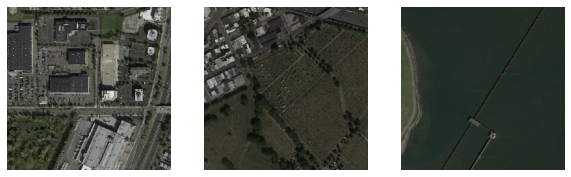

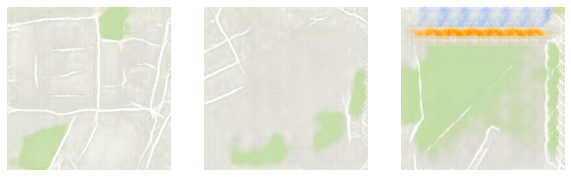

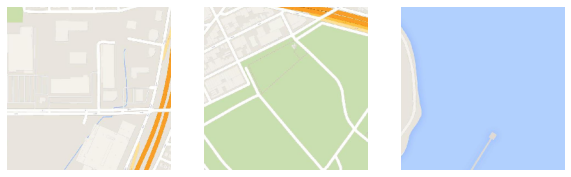

>1097, d1[0.008] d2[0.002] g[0.086]
>1098, d1[0.003] d2[0.002] g[0.114]
>1099, d1[0.007] d2[0.005] g[0.068]
>1100, d1[0.004] d2[0.001] g[0.112]
>1101, d1[0.008] d2[0.015] g[0.075]
>1102, d1[0.007] d2[0.002] g[0.069]
>1103, d1[0.010] d2[0.007] g[0.077]
>1104, d1[0.008] d2[0.003] g[0.067]
>1105, d1[0.008] d2[0.005] g[0.076]
>1106, d1[0.003] d2[0.014] g[0.134]
>1107, d1[0.003] d2[0.002] g[0.110]
>1108, d1[0.014] d2[0.004] g[0.072]
>1109, d1[0.006] d2[0.004] g[0.182]
>1110, d1[0.004] d2[0.003] g[0.107]
>1111, d1[0.006] d2[0.004] g[0.084]
>1112, d1[0.012] d2[0.006] g[0.076]
>1113, d1[0.002] d2[0.004] g[0.137]
>1114, d1[0.006] d2[0.007] g[0.070]
>1115, d1[0.003] d2[0.003] g[0.082]
>1116, d1[0.005] d2[0.004] g[0.069]
>1117, d1[0.006] d2[0.004] g[0.075]
>1118, d1[0.007] d2[0.004] g[0.080]
>1119, d1[0.016] d2[0.004] g[0.166]
>1120, d1[0.002] d2[0.004] g[0.111]
>1121, d1[0.006] d2[0.003] g[0.131]
>1122, d1[0.004] d2[0.009] g[0.108]
>1123, d1[0.003] d2[0.005] g[0.123]
>1124, d1[0.003] d2[0.004] g

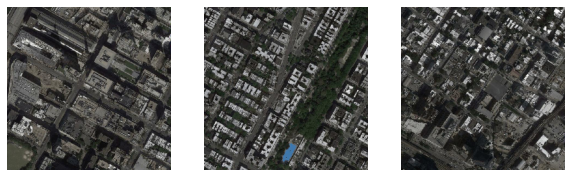

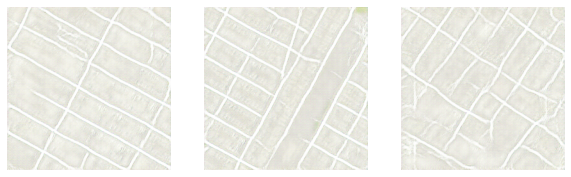

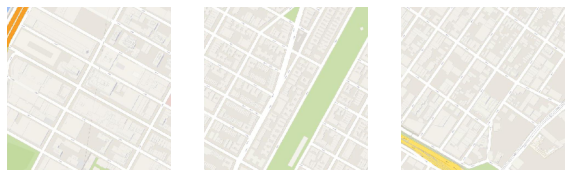

>2193, d1[0.000] d2[0.000] g[0.119]
>2194, d1[0.000] d2[0.000] g[0.112]
>2195, d1[0.000] d2[0.000] g[0.151]
>2196, d1[0.001] d2[0.000] g[0.096]
>2197, d1[0.001] d2[0.001] g[0.063]
>2198, d1[0.001] d2[0.001] g[0.077]
>2199, d1[0.000] d2[0.000] g[0.187]
>2200, d1[0.001] d2[0.001] g[0.068]
>2201, d1[0.001] d2[0.001] g[0.077]
>2202, d1[0.001] d2[0.000] g[0.160]
>2203, d1[0.000] d2[0.000] g[0.066]
>2204, d1[0.001] d2[0.000] g[0.074]
>2205, d1[0.000] d2[0.000] g[0.131]
>2206, d1[0.000] d2[0.001] g[0.153]
>2207, d1[0.000] d2[0.000] g[0.165]
>2208, d1[0.000] d2[0.000] g[0.126]
>2209, d1[0.001] d2[0.000] g[0.080]
>2210, d1[0.001] d2[0.001] g[0.075]
>2211, d1[0.000] d2[0.001] g[0.068]
>2212, d1[0.001] d2[0.001] g[0.074]
>2213, d1[0.001] d2[0.001] g[0.088]
>2214, d1[0.000] d2[0.000] g[0.080]
>2215, d1[0.000] d2[0.000] g[0.139]
>2216, d1[0.000] d2[0.003] g[0.077]
>2217, d1[0.001] d2[0.001] g[0.067]
>2218, d1[0.001] d2[0.000] g[0.073]
>2219, d1[0.001] d2[0.000] g[0.074]
>2220, d1[0.000] d2[0.000] g

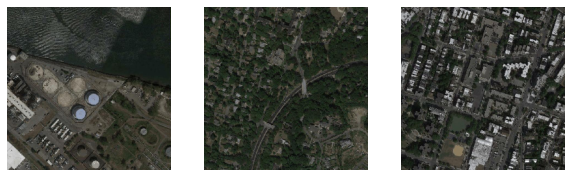

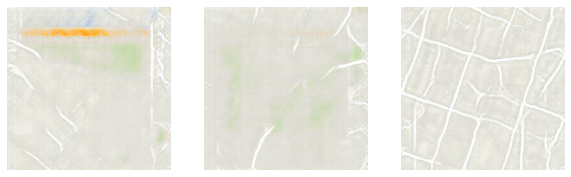

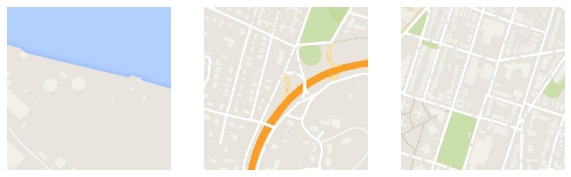

>3289, d1[0.000] d2[0.000] g[0.090]
>3290, d1[0.000] d2[0.000] g[0.076]
>3291, d1[0.000] d2[0.000] g[0.089]
>3292, d1[0.000] d2[0.000] g[0.093]
>3293, d1[0.000] d2[0.000] g[0.116]
>3294, d1[0.000] d2[0.000] g[0.065]
>3295, d1[0.000] d2[0.000] g[0.069]
>3296, d1[0.000] d2[0.000] g[0.192]
>3297, d1[0.000] d2[0.000] g[0.066]
>3298, d1[0.000] d2[0.000] g[0.182]
>3299, d1[0.000] d2[0.000] g[0.069]
>3300, d1[0.000] d2[0.000] g[0.093]
>3301, d1[0.000] d2[0.001] g[0.068]
>3302, d1[0.000] d2[0.000] g[0.067]
>3303, d1[0.000] d2[0.000] g[0.132]
>3304, d1[0.000] d2[0.000] g[0.194]
>3305, d1[0.000] d2[0.000] g[0.203]
>3306, d1[0.000] d2[0.000] g[0.112]
>3307, d1[0.000] d2[0.001] g[0.064]
>3308, d1[0.000] d2[0.000] g[0.085]
>3309, d1[0.000] d2[0.001] g[0.072]
>3310, d1[0.000] d2[0.000] g[0.059]
>3311, d1[0.000] d2[0.000] g[0.067]
>3312, d1[0.000] d2[0.001] g[0.064]
>3313, d1[0.000] d2[0.000] g[0.152]
>3314, d1[0.000] d2[0.000] g[0.061]
>3315, d1[0.000] d2[0.000] g[0.079]
>3316, d1[0.000] d2[0.000] g

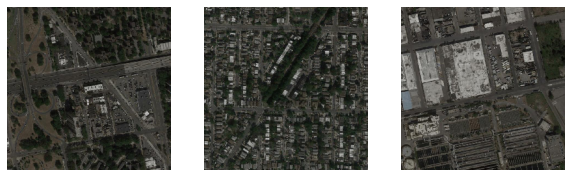

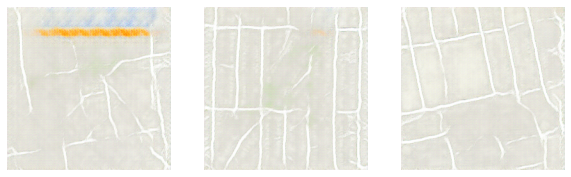

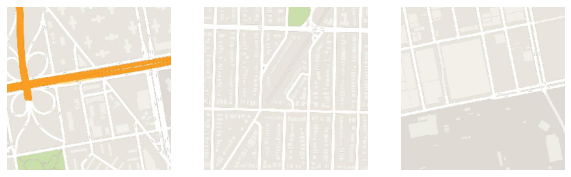

>4385, d1[0.000] d2[0.000] g[0.128]
>4386, d1[0.000] d2[0.000] g[0.067]
>4387, d1[0.000] d2[0.000] g[0.064]
>4388, d1[0.000] d2[0.000] g[0.107]
>4389, d1[0.000] d2[0.000] g[0.080]
>4390, d1[0.000] d2[0.000] g[0.087]
>4391, d1[0.000] d2[0.000] g[0.118]
>4392, d1[0.000] d2[0.000] g[0.062]
>4393, d1[0.000] d2[0.000] g[0.106]
>4394, d1[0.000] d2[0.000] g[0.068]
>4395, d1[0.000] d2[0.000] g[0.165]
>4396, d1[0.000] d2[0.000] g[0.136]
>4397, d1[0.000] d2[0.000] g[0.111]
>4398, d1[0.000] d2[0.000] g[0.064]
>4399, d1[0.000] d2[0.000] g[0.165]
>4400, d1[0.000] d2[0.000] g[0.073]
>4401, d1[0.000] d2[0.000] g[0.114]
>4402, d1[0.000] d2[0.000] g[0.114]
>4403, d1[0.000] d2[0.000] g[0.077]
>4404, d1[0.000] d2[0.000] g[0.067]
>4405, d1[0.000] d2[0.000] g[0.058]
>4406, d1[0.000] d2[0.000] g[0.124]
>4407, d1[0.000] d2[0.000] g[0.180]
>4408, d1[0.000] d2[0.000] g[0.102]
>4409, d1[0.000] d2[0.000] g[0.068]
>4410, d1[0.000] d2[0.000] g[0.146]
>4411, d1[0.000] d2[0.000] g[0.056]
>4412, d1[0.000] d2[0.000] g

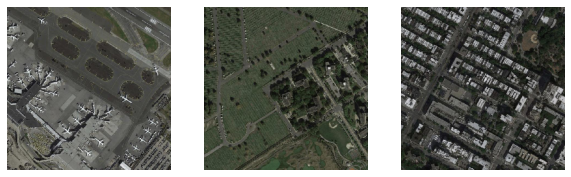

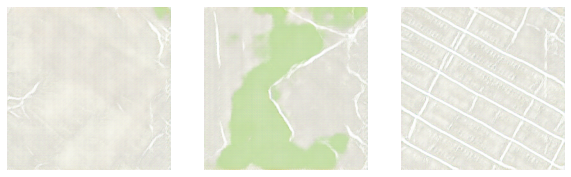

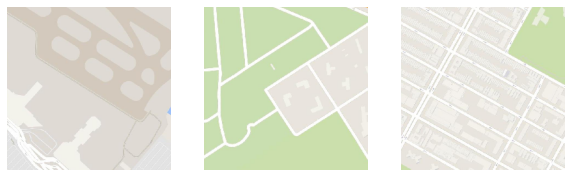

>5481, d1[0.000] d2[0.000] g[0.152]
>5482, d1[0.000] d2[0.000] g[0.076]
>5483, d1[0.000] d2[0.000] g[0.108]
>5484, d1[0.000] d2[0.000] g[0.201]
>5485, d1[0.000] d2[0.000] g[0.166]
>5486, d1[0.000] d2[0.000] g[0.060]
>5487, d1[0.000] d2[0.000] g[0.063]
>5488, d1[0.000] d2[0.000] g[0.136]
>5489, d1[0.000] d2[0.000] g[0.079]
>5490, d1[0.000] d2[0.000] g[0.114]
>5491, d1[0.000] d2[0.000] g[0.204]
>5492, d1[0.000] d2[0.000] g[0.111]
>5493, d1[0.000] d2[0.000] g[0.073]
>5494, d1[0.000] d2[0.000] g[0.136]
>5495, d1[0.000] d2[0.000] g[0.066]
>5496, d1[0.000] d2[0.000] g[0.118]
>5497, d1[0.000] d2[0.000] g[0.076]
>5498, d1[0.000] d2[0.000] g[0.067]
>5499, d1[0.000] d2[0.000] g[0.203]
>5500, d1[0.000] d2[0.000] g[0.092]
>5501, d1[0.000] d2[0.000] g[0.093]
>5502, d1[0.000] d2[0.000] g[0.130]
>5503, d1[0.000] d2[0.000] g[0.078]
>5504, d1[0.000] d2[0.000] g[0.081]
>5505, d1[0.000] d2[0.000] g[0.060]
>5506, d1[0.000] d2[0.000] g[0.129]
>5507, d1[0.000] d2[0.000] g[0.083]
>5508, d1[0.000] d2[0.000] g

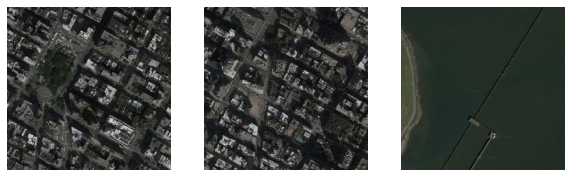

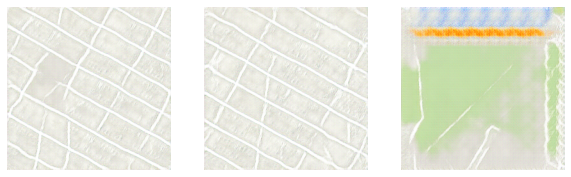

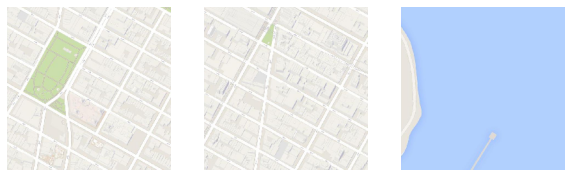

>6577, d1[0.000] d2[0.000] g[0.258]
>6578, d1[0.000] d2[0.000] g[0.053]
>6579, d1[0.000] d2[0.000] g[0.064]
>6580, d1[0.000] d2[0.000] g[0.113]
>6581, d1[0.000] d2[0.000] g[0.066]
>6582, d1[0.000] d2[0.000] g[0.128]
>6583, d1[0.000] d2[0.000] g[0.050]
>6584, d1[0.000] d2[0.000] g[0.077]
>6585, d1[0.000] d2[0.000] g[0.239]
>6586, d1[0.000] d2[0.000] g[0.108]
>6587, d1[0.000] d2[0.000] g[0.098]
>6588, d1[0.000] d2[0.000] g[0.108]
>6589, d1[0.000] d2[0.000] g[0.108]
>6590, d1[0.000] d2[0.000] g[0.076]
>6591, d1[0.000] d2[0.000] g[0.072]
>6592, d1[0.000] d2[0.000] g[0.075]
>6593, d1[0.000] d2[0.000] g[0.057]
>6594, d1[0.000] d2[0.000] g[0.178]
>6595, d1[0.000] d2[0.000] g[0.058]
>6596, d1[0.000] d2[0.000] g[0.081]
>6597, d1[0.000] d2[0.000] g[0.117]
>6598, d1[0.000] d2[0.000] g[0.042]
>6599, d1[0.000] d2[0.000] g[0.108]
>6600, d1[0.000] d2[0.000] g[0.068]
>6601, d1[0.000] d2[0.000] g[0.081]
>6602, d1[0.000] d2[0.000] g[0.094]
>6603, d1[0.000] d2[0.000] g[0.050]
>6604, d1[0.000] d2[0.000] g

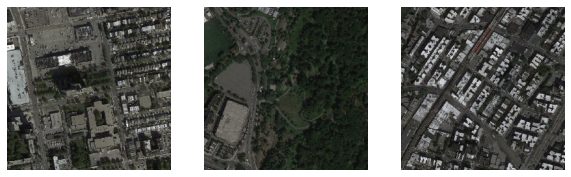

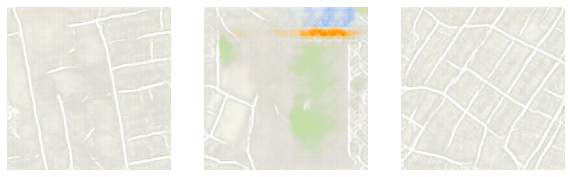

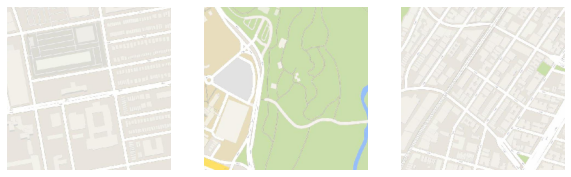

>7673, d1[0.000] d2[0.000] g[0.062]
>7674, d1[0.000] d2[0.000] g[0.080]
>7675, d1[0.000] d2[0.000] g[0.080]
>7676, d1[0.000] d2[0.000] g[0.081]
>7677, d1[0.000] d2[0.000] g[0.129]
>7678, d1[0.000] d2[0.000] g[0.147]
>7679, d1[0.000] d2[0.000] g[0.103]
>7680, d1[0.000] d2[0.000] g[0.125]
>7681, d1[0.000] d2[0.000] g[0.075]
>7682, d1[0.000] d2[0.000] g[0.077]
>7683, d1[0.000] d2[0.000] g[0.047]
>7684, d1[0.000] d2[0.000] g[0.108]
>7685, d1[0.000] d2[0.000] g[0.095]
>7686, d1[0.000] d2[0.000] g[0.173]
>7687, d1[0.000] d2[0.000] g[0.058]
>7688, d1[0.000] d2[0.000] g[0.060]
>7689, d1[0.000] d2[0.000] g[0.070]
>7690, d1[0.000] d2[0.000] g[0.089]
>7691, d1[0.000] d2[0.000] g[0.127]
>7692, d1[0.000] d2[0.000] g[0.083]
>7693, d1[0.000] d2[0.000] g[0.104]
>7694, d1[0.000] d2[0.000] g[0.129]
>7695, d1[0.000] d2[0.000] g[0.061]
>7696, d1[0.000] d2[0.000] g[0.174]
>7697, d1[0.000] d2[0.000] g[0.067]
>7698, d1[0.000] d2[0.000] g[0.088]
>7699, d1[0.000] d2[0.000] g[0.106]
>7700, d1[0.000] d2[0.000] g

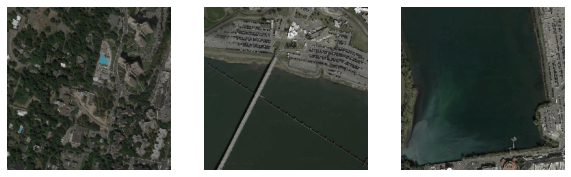

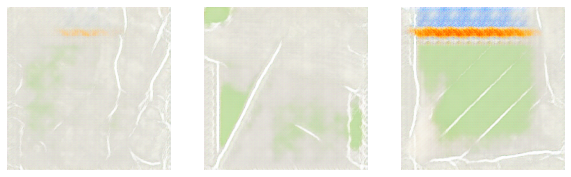

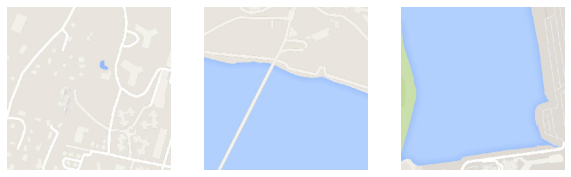

>8769, d1[0.000] d2[0.000] g[0.060]
>8770, d1[0.000] d2[0.000] g[0.121]
>8771, d1[0.000] d2[0.000] g[0.083]
>8772, d1[0.000] d2[0.000] g[0.078]
>8773, d1[0.000] d2[0.000] g[0.126]
>8774, d1[0.000] d2[0.000] g[0.068]
>8775, d1[0.000] d2[0.000] g[0.076]
>8776, d1[0.000] d2[0.000] g[0.066]
>8777, d1[0.000] d2[0.000] g[0.147]
>8778, d1[0.000] d2[0.000] g[0.072]
>8779, d1[0.000] d2[0.000] g[0.067]
>8780, d1[0.000] d2[0.000] g[0.204]
>8781, d1[0.000] d2[0.000] g[0.122]
>8782, d1[0.000] d2[0.000] g[0.124]
>8783, d1[0.000] d2[0.000] g[0.087]
>8784, d1[0.000] d2[0.000] g[0.106]
>8785, d1[0.000] d2[0.000] g[0.060]
>8786, d1[0.000] d2[0.000] g[0.128]
>8787, d1[0.000] d2[0.000] g[0.082]
>8788, d1[0.000] d2[0.000] g[0.060]
>8789, d1[0.000] d2[0.000] g[0.160]
>8790, d1[0.000] d2[0.000] g[0.078]
>8791, d1[0.000] d2[0.000] g[0.111]
>8792, d1[0.000] d2[0.000] g[0.081]
>8793, d1[0.000] d2[0.000] g[0.063]
>8794, d1[0.000] d2[0.000] g[0.069]
>8795, d1[0.000] d2[0.000] g[0.074]
>8796, d1[0.000] d2[0.000] g

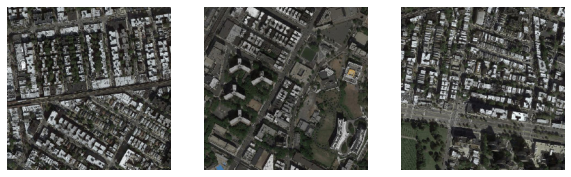

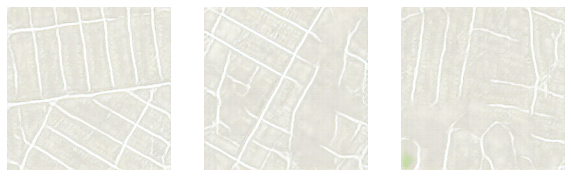

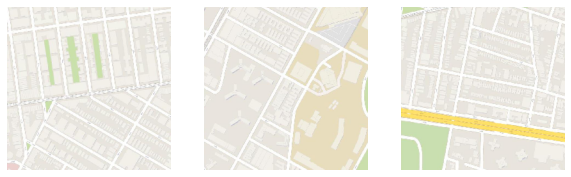

>9865, d1[0.000] d2[0.000] g[0.063]
>9866, d1[0.000] d2[0.000] g[0.074]
>9867, d1[0.000] d2[0.000] g[0.099]
>9868, d1[0.000] d2[0.000] g[0.063]
>9869, d1[0.000] d2[0.000] g[0.091]
>9870, d1[0.000] d2[0.000] g[0.072]
>9871, d1[0.000] d2[0.000] g[0.071]
>9872, d1[0.000] d2[0.000] g[0.159]
>9873, d1[0.000] d2[0.000] g[0.117]
>9874, d1[0.000] d2[0.000] g[0.165]
>9875, d1[0.000] d2[0.000] g[0.069]
>9876, d1[0.000] d2[0.000] g[0.083]
>9877, d1[0.000] d2[0.000] g[0.089]
>9878, d1[0.000] d2[0.000] g[0.063]
>9879, d1[0.000] d2[0.000] g[0.063]
>9880, d1[0.000] d2[0.000] g[0.056]
>9881, d1[0.000] d2[0.000] g[0.154]
>9882, d1[0.000] d2[0.000] g[0.056]
>9883, d1[0.000] d2[0.000] g[0.130]
>9884, d1[0.000] d2[0.000] g[0.093]
>9885, d1[0.000] d2[0.000] g[0.089]
>9886, d1[0.000] d2[0.000] g[0.043]
>9887, d1[0.000] d2[0.000] g[0.120]
>9888, d1[0.000] d2[0.000] g[0.235]
>9889, d1[0.000] d2[0.000] g[0.080]
>9890, d1[0.000] d2[0.000] g[0.048]
>9891, d1[0.000] d2[0.000] g[0.072]
>9892, d1[0.000] d2[0.000] g

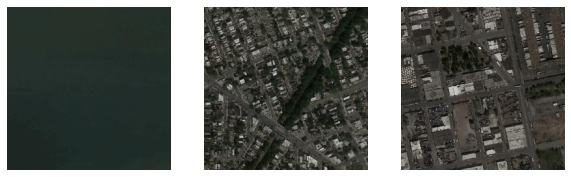

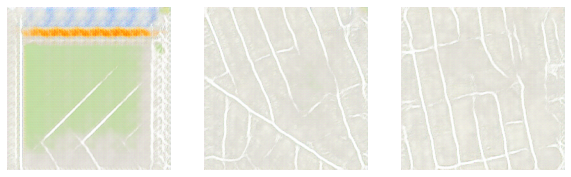

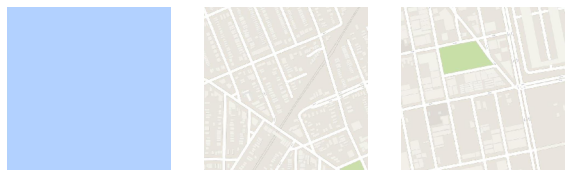

>10961, d1[0.000] d2[0.000] g[0.058]
>10962, d1[0.000] d2[0.000] g[0.036]
>10963, d1[0.000] d2[0.000] g[0.061]
>10964, d1[0.000] d2[0.000] g[0.059]
>10965, d1[0.000] d2[0.000] g[0.060]
>10966, d1[0.000] d2[0.000] g[0.049]
>10967, d1[0.000] d2[0.000] g[0.156]
>10968, d1[0.000] d2[0.000] g[0.073]
>10969, d1[0.000] d2[0.000] g[0.094]
>10970, d1[0.000] d2[0.000] g[0.128]
>10971, d1[0.000] d2[0.000] g[0.074]
>10972, d1[0.000] d2[0.000] g[0.067]
>10973, d1[0.000] d2[0.000] g[0.078]
>10974, d1[0.000] d2[0.000] g[0.087]
>10975, d1[0.000] d2[0.000] g[0.020]
>10976, d1[0.000] d2[0.000] g[0.077]
>10977, d1[0.000] d2[0.000] g[0.122]
>10978, d1[0.000] d2[0.000] g[0.072]
>10979, d1[0.000] d2[0.000] g[0.030]
>10980, d1[0.000] d2[0.000] g[0.077]
>10981, d1[0.000] d2[0.000] g[0.017]
>10982, d1[0.000] d2[0.000] g[0.071]
>10983, d1[0.000] d2[0.000] g[0.070]
>10984, d1[0.000] d2[0.000] g[0.071]
>10985, d1[0.000] d2[0.000] g[0.057]
>10986, d1[0.000] d2[0.000] g[0.111]
>10987, d1[0.000] d2[0.000] g[0.058]
>

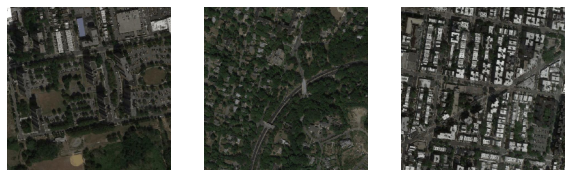

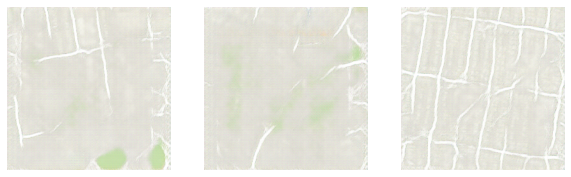

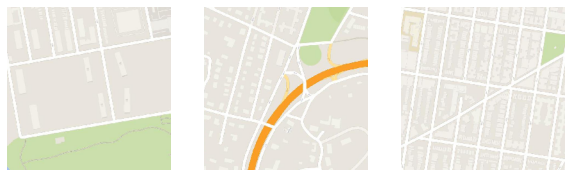

>12057, d1[0.000] d2[0.000] g[0.084]
>12058, d1[0.000] d2[0.000] g[0.074]
>12059, d1[0.000] d2[0.000] g[0.068]
>12060, d1[0.000] d2[0.000] g[0.061]
>12061, d1[0.000] d2[0.000] g[0.105]
>12062, d1[0.000] d2[0.000] g[0.099]
>12063, d1[0.000] d2[0.000] g[0.059]
>12064, d1[0.000] d2[0.000] g[0.156]
>12065, d1[0.000] d2[0.000] g[0.064]
>12066, d1[0.000] d2[0.000] g[0.099]
>12067, d1[0.000] d2[0.000] g[0.062]
>12068, d1[0.000] d2[0.000] g[0.012]
>12069, d1[0.000] d2[0.000] g[0.056]
>12070, d1[0.000] d2[0.000] g[0.110]
>12071, d1[0.000] d2[0.000] g[0.056]
>12072, d1[0.000] d2[0.000] g[0.108]
>12073, d1[0.000] d2[0.000] g[0.063]
>12074, d1[0.000] d2[0.000] g[0.061]
>12075, d1[0.000] d2[0.000] g[0.103]
>12076, d1[0.000] d2[0.000] g[0.092]
>12077, d1[0.000] d2[0.000] g[0.079]
>12078, d1[0.000] d2[0.000] g[0.065]
>12079, d1[0.000] d2[0.000] g[0.103]
>12080, d1[0.000] d2[0.000] g[0.055]
>12081, d1[0.000] d2[0.000] g[0.057]
>12082, d1[0.000] d2[0.000] g[0.061]
>12083, d1[0.000] d2[0.000] g[0.071]
>

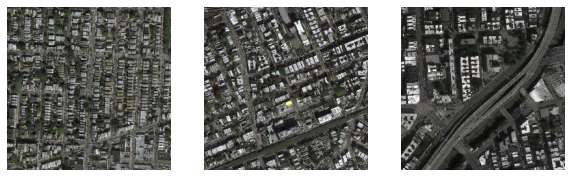

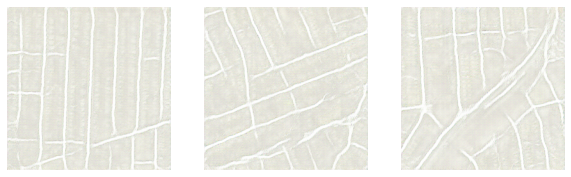

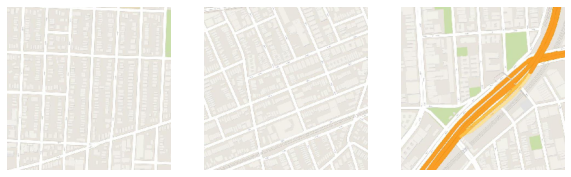

>13153, d1[0.000] d2[0.000] g[0.078]
>13154, d1[0.000] d2[0.000] g[0.068]
>13155, d1[0.000] d2[0.000] g[0.071]
>13156, d1[0.000] d2[0.000] g[0.170]
>13157, d1[0.000] d2[0.000] g[0.105]
>13158, d1[0.000] d2[0.000] g[0.058]
>13159, d1[0.000] d2[0.000] g[0.061]
>13160, d1[0.000] d2[0.000] g[0.058]
>13161, d1[0.000] d2[0.000] g[0.061]
>13162, d1[0.000] d2[0.000] g[0.074]
>13163, d1[0.000] d2[0.000] g[0.014]
>13164, d1[0.000] d2[0.000] g[0.064]
>13165, d1[0.000] d2[0.000] g[0.064]
>13166, d1[0.000] d2[0.000] g[0.074]
>13167, d1[0.000] d2[0.000] g[0.097]
>13168, d1[0.000] d2[0.000] g[0.061]
>13169, d1[0.000] d2[0.000] g[0.059]
>13170, d1[0.000] d2[0.000] g[0.044]
>13171, d1[0.000] d2[0.000] g[0.087]
>13172, d1[0.000] d2[0.000] g[0.050]
>13173, d1[0.000] d2[0.000] g[0.100]
>13174, d1[0.000] d2[0.000] g[0.066]
>13175, d1[0.000] d2[0.000] g[0.066]
>13176, d1[0.000] d2[0.000] g[0.122]
>13177, d1[0.000] d2[0.000] g[0.024]
>13178, d1[0.000] d2[0.000] g[0.106]
>13179, d1[0.000] d2[0.000] g[0.082]
>

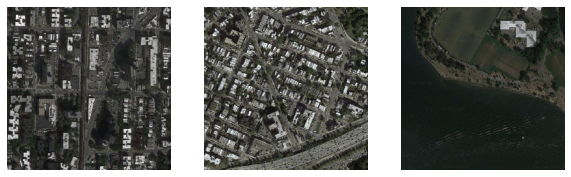

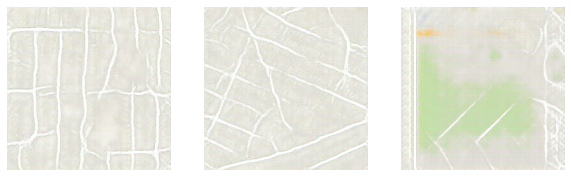

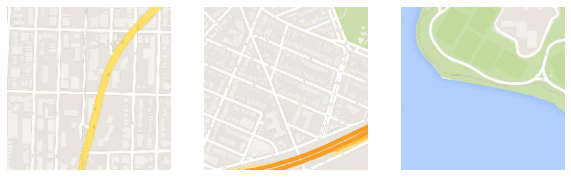

>14249, d1[0.000] d2[0.000] g[0.060]
>14250, d1[0.000] d2[0.000] g[0.071]
>14251, d1[0.000] d2[0.000] g[0.056]
>14252, d1[0.000] d2[0.000] g[0.054]
>14253, d1[0.000] d2[0.000] g[0.050]
>14254, d1[0.000] d2[0.000] g[0.056]
>14255, d1[0.000] d2[0.000] g[0.079]
>14256, d1[0.000] d2[0.000] g[0.095]
>14257, d1[0.000] d2[0.000] g[0.059]
>14258, d1[0.000] d2[0.000] g[0.034]
>14259, d1[0.000] d2[0.000] g[0.097]
>14260, d1[0.000] d2[0.000] g[0.070]
>14261, d1[0.000] d2[0.000] g[0.060]
>14262, d1[0.000] d2[0.000] g[0.055]
>14263, d1[0.000] d2[0.000] g[0.060]
>14264, d1[0.000] d2[0.000] g[0.046]
>14265, d1[0.000] d2[0.000] g[0.020]
>14266, d1[0.000] d2[0.000] g[0.084]
>14267, d1[0.000] d2[0.000] g[0.063]
>14268, d1[0.000] d2[0.000] g[0.058]
>14269, d1[0.000] d2[0.000] g[0.052]
>14270, d1[0.000] d2[0.000] g[0.168]
>14271, d1[0.000] d2[0.000] g[0.092]
>14272, d1[0.000] d2[0.000] g[0.109]
>14273, d1[0.000] d2[0.000] g[0.069]
>14274, d1[0.000] d2[0.000] g[0.094]
>14275, d1[0.000] d2[0.000] g[0.104]
>

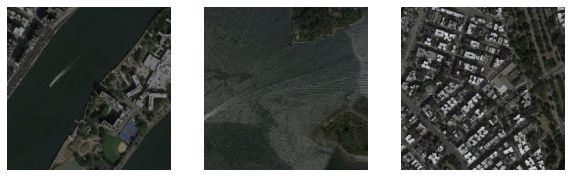

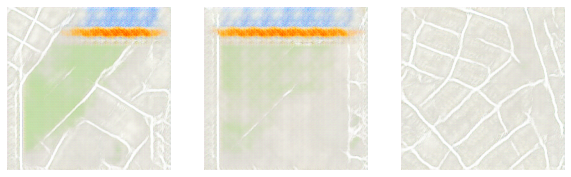

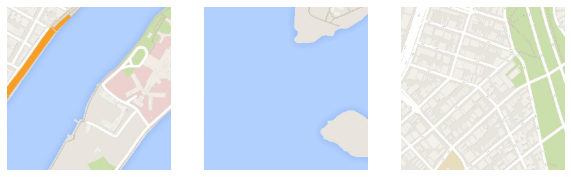

>15345, d1[0.000] d2[0.000] g[0.088]
>15346, d1[0.000] d2[0.000] g[0.081]
>15347, d1[0.000] d2[0.000] g[0.113]
>15348, d1[0.000] d2[0.000] g[0.062]
>15349, d1[0.000] d2[0.000] g[0.074]
>15350, d1[0.000] d2[0.000] g[0.065]
>15351, d1[0.000] d2[0.000] g[0.059]
>15352, d1[0.000] d2[0.000] g[0.071]
>15353, d1[0.000] d2[0.000] g[0.020]
>15354, d1[0.000] d2[0.000] g[0.066]
>15355, d1[0.000] d2[0.000] g[0.091]
>15356, d1[0.000] d2[0.000] g[0.066]
>15357, d1[0.000] d2[0.000] g[0.061]
>15358, d1[0.000] d2[0.000] g[0.090]
>15359, d1[0.000] d2[0.000] g[0.054]
>15360, d1[0.000] d2[0.000] g[0.067]
>15361, d1[0.000] d2[0.000] g[0.107]
>15362, d1[0.000] d2[0.000] g[0.015]
>15363, d1[0.000] d2[0.000] g[0.060]
>15364, d1[0.000] d2[0.000] g[0.063]
>15365, d1[0.000] d2[0.000] g[0.096]
>15366, d1[0.000] d2[0.000] g[0.062]
>15367, d1[0.000] d2[0.000] g[0.075]
>15368, d1[0.000] d2[0.000] g[0.053]
>15369, d1[0.000] d2[0.000] g[0.084]
>15370, d1[0.000] d2[0.000] g[0.068]
>15371, d1[0.000] d2[0.000] g[0.055]
>

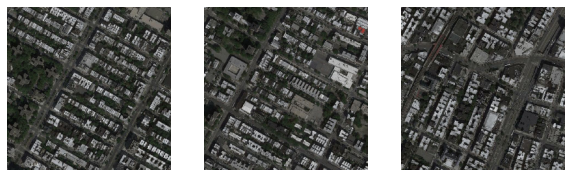

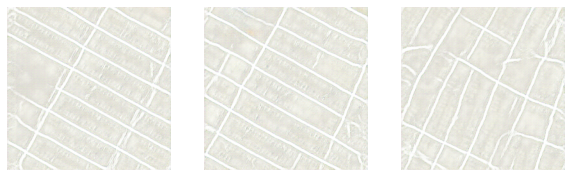

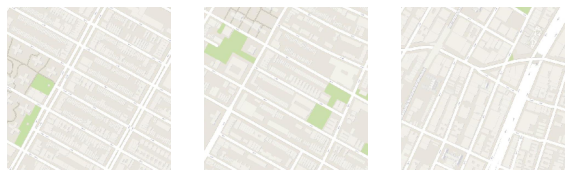

>16441, d1[0.000] d2[0.000] g[0.021]
>16442, d1[0.000] d2[0.000] g[0.034]
>16443, d1[0.000] d2[0.000] g[0.056]
>16444, d1[0.000] d2[0.000] g[0.075]
>16445, d1[0.000] d2[0.000] g[0.102]
>16446, d1[0.000] d2[0.000] g[0.058]
>16447, d1[0.000] d2[0.000] g[0.052]
>16448, d1[0.000] d2[0.000] g[0.019]
>16449, d1[0.000] d2[0.000] g[0.056]
>16450, d1[0.000] d2[0.000] g[0.063]
>16451, d1[0.000] d2[0.000] g[0.067]
>16452, d1[0.000] d2[0.000] g[0.114]
>16453, d1[0.000] d2[0.000] g[0.021]
>16454, d1[0.000] d2[0.000] g[0.099]
>16455, d1[0.000] d2[0.000] g[0.070]
>16456, d1[0.000] d2[0.000] g[0.062]
>16457, d1[0.000] d2[0.000] g[0.115]
>16458, d1[0.000] d2[0.000] g[0.084]
>16459, d1[0.000] d2[0.000] g[0.074]
>16460, d1[0.000] d2[0.000] g[0.076]
>16461, d1[0.000] d2[0.000] g[0.202]
>16462, d1[0.000] d2[0.000] g[0.084]
>16463, d1[0.000] d2[0.000] g[0.046]
>16464, d1[0.000] d2[0.000] g[0.058]
>16465, d1[0.000] d2[0.000] g[0.072]
>16466, d1[0.000] d2[0.000] g[0.051]
>16467, d1[0.000] d2[0.000] g[0.066]
>

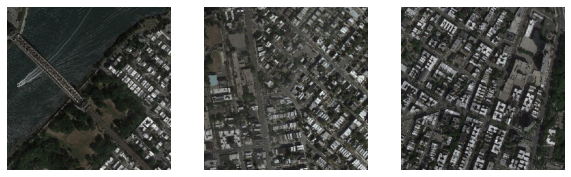

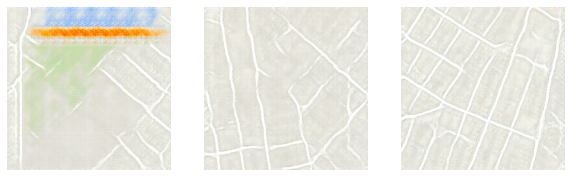

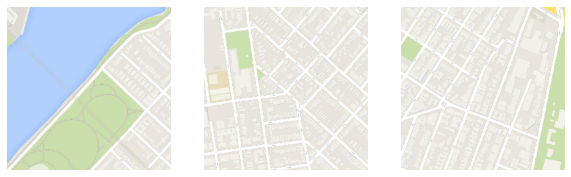

>17537, d1[0.000] d2[0.000] g[0.079]
>17538, d1[0.000] d2[0.000] g[0.072]
>17539, d1[0.000] d2[0.000] g[0.074]
>17540, d1[0.000] d2[0.000] g[0.056]
>17541, d1[0.000] d2[0.000] g[0.043]
>17542, d1[0.000] d2[0.000] g[0.095]
>17543, d1[0.000] d2[0.000] g[0.064]
>17544, d1[0.000] d2[0.000] g[0.067]
>17545, d1[0.000] d2[0.000] g[0.049]
>17546, d1[0.000] d2[0.000] g[0.076]
>17547, d1[0.000] d2[0.000] g[0.044]
>17548, d1[0.000] d2[0.000] g[0.068]
>17549, d1[0.000] d2[0.000] g[0.107]
>17550, d1[0.000] d2[0.000] g[0.063]
>17551, d1[0.000] d2[0.000] g[0.056]
>17552, d1[0.000] d2[0.000] g[0.056]
>17553, d1[0.000] d2[0.000] g[0.067]
>17554, d1[0.000] d2[0.000] g[0.060]
>17555, d1[0.000] d2[0.000] g[0.057]
>17556, d1[0.000] d2[0.000] g[0.054]
>17557, d1[0.000] d2[0.000] g[0.051]
>17558, d1[0.000] d2[0.000] g[0.012]
>17559, d1[0.000] d2[0.000] g[0.080]
>17560, d1[0.000] d2[0.000] g[0.105]
>17561, d1[0.000] d2[0.000] g[0.102]
>17562, d1[0.000] d2[0.000] g[0.060]
>17563, d1[0.000] d2[0.000] g[0.081]
>

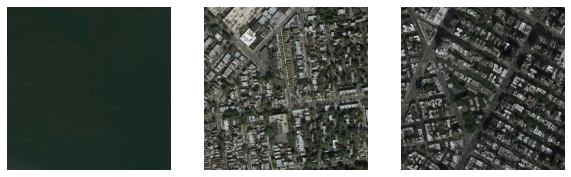

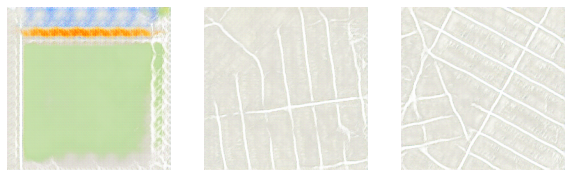

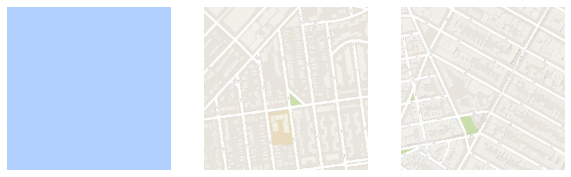

>18633, d1[0.000] d2[0.000] g[0.056]
>18634, d1[0.000] d2[0.000] g[0.065]
>18635, d1[0.000] d2[0.000] g[0.070]
>18636, d1[0.000] d2[0.000] g[0.061]
>18637, d1[0.000] d2[0.000] g[0.050]
>18638, d1[0.000] d2[0.000] g[0.051]
>18639, d1[0.000] d2[0.000] g[0.057]
>18640, d1[0.000] d2[0.000] g[0.086]
>18641, d1[0.000] d2[0.000] g[0.066]
>18642, d1[0.000] d2[0.000] g[0.046]
>18643, d1[0.000] d2[0.000] g[0.067]
>18644, d1[0.000] d2[0.000] g[0.057]
>18645, d1[0.000] d2[0.000] g[0.065]
>18646, d1[0.000] d2[0.000] g[0.084]
>18647, d1[0.000] d2[0.000] g[0.057]
>18648, d1[0.000] d2[0.000] g[0.061]
>18649, d1[0.000] d2[0.000] g[0.063]
>18650, d1[0.000] d2[0.000] g[0.056]
>18651, d1[0.000] d2[0.000] g[0.082]
>18652, d1[0.000] d2[0.000] g[0.052]
>18653, d1[0.000] d2[0.000] g[0.054]
>18654, d1[0.000] d2[0.000] g[0.040]
>18655, d1[0.000] d2[0.000] g[0.054]
>18656, d1[0.000] d2[0.000] g[0.058]
>18657, d1[0.000] d2[0.000] g[0.057]
>18658, d1[0.000] d2[0.000] g[0.056]
>18659, d1[0.000] d2[0.000] g[0.074]
>

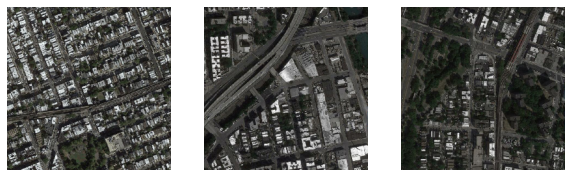

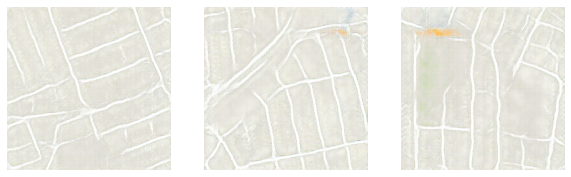

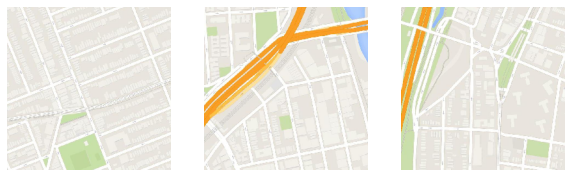

>19729, d1[0.000] d2[0.000] g[0.054]
>19730, d1[0.000] d2[0.000] g[0.060]
>19731, d1[0.000] d2[0.000] g[0.071]
>19732, d1[0.000] d2[0.000] g[0.036]
>19733, d1[0.000] d2[0.000] g[0.018]
>19734, d1[0.000] d2[0.000] g[0.056]
>19735, d1[0.000] d2[0.000] g[0.096]
>19736, d1[0.000] d2[0.000] g[0.058]
>19737, d1[0.000] d2[0.000] g[0.049]
>19738, d1[0.000] d2[0.000] g[0.054]
>19739, d1[0.000] d2[0.000] g[0.082]
>19740, d1[0.000] d2[0.000] g[0.027]
>19741, d1[0.000] d2[0.000] g[0.051]
>19742, d1[0.000] d2[0.000] g[0.088]
>19743, d1[0.000] d2[0.000] g[0.069]
>19744, d1[0.000] d2[0.000] g[0.070]
>19745, d1[0.000] d2[0.000] g[0.130]
>19746, d1[0.000] d2[0.000] g[0.052]
>19747, d1[0.000] d2[0.000] g[0.063]
>19748, d1[0.000] d2[0.000] g[0.171]
>19749, d1[0.000] d2[0.000] g[0.056]
>19750, d1[0.000] d2[0.000] g[0.070]
>19751, d1[0.000] d2[0.000] g[0.051]
>19752, d1[0.000] d2[0.000] g[0.066]
>19753, d1[0.000] d2[0.000] g[0.096]
>19754, d1[0.000] d2[0.000] g[0.049]
>19755, d1[0.000] d2[0.000] g[0.053]
>

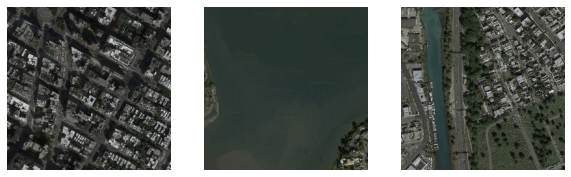

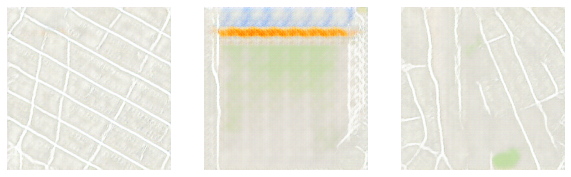

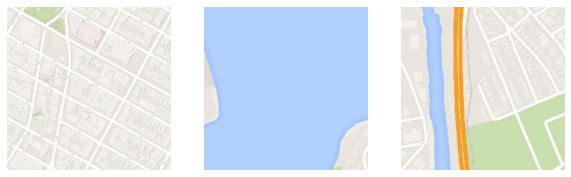

>20825, d1[0.000] d2[0.000] g[0.051]
>20826, d1[0.000] d2[0.000] g[0.057]
>20827, d1[0.000] d2[0.000] g[0.059]
>20828, d1[0.000] d2[0.000] g[0.037]
>20829, d1[0.000] d2[0.000] g[0.068]
>20830, d1[0.000] d2[0.000] g[0.064]
>20831, d1[0.000] d2[0.000] g[0.058]
>20832, d1[0.000] d2[0.000] g[0.018]
>20833, d1[0.000] d2[0.000] g[0.059]
>20834, d1[0.000] d2[0.000] g[0.079]
>20835, d1[0.000] d2[0.000] g[0.067]
>20836, d1[0.000] d2[0.000] g[0.068]
>20837, d1[0.000] d2[0.000] g[0.059]
>20838, d1[0.000] d2[0.000] g[0.094]
>20839, d1[0.000] d2[0.000] g[0.055]
>20840, d1[0.000] d2[0.000] g[0.081]
>20841, d1[0.000] d2[0.000] g[0.051]
>20842, d1[0.000] d2[0.000] g[0.044]
>20843, d1[0.000] d2[0.000] g[0.047]
>20844, d1[0.000] d2[0.000] g[0.054]
>20845, d1[0.000] d2[0.000] g[0.048]
>20846, d1[0.000] d2[0.000] g[0.062]
>20847, d1[0.000] d2[0.000] g[0.049]
>20848, d1[0.000] d2[0.000] g[0.050]
>20849, d1[0.000] d2[0.000] g[0.008]
>20850, d1[0.000] d2[0.000] g[0.052]
>20851, d1[0.000] d2[0.000] g[0.054]
>

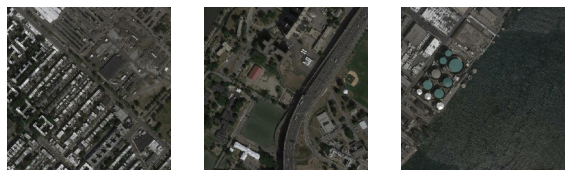

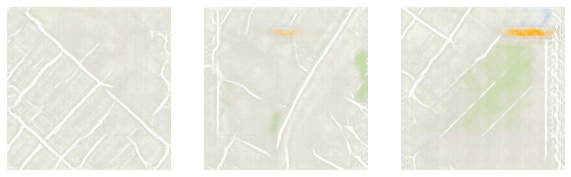

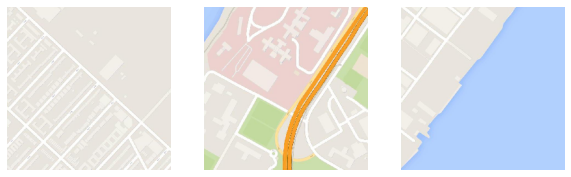

>21921, d1[0.000] d2[0.000] g[0.008]
>21922, d1[0.000] d2[0.000] g[0.076]
>21923, d1[0.000] d2[0.000] g[0.050]
>21924, d1[0.000] d2[0.000] g[0.028]
>21925, d1[0.000] d2[0.000] g[0.072]
>21926, d1[0.000] d2[0.000] g[0.094]
>21927, d1[0.000] d2[0.000] g[0.042]
>21928, d1[0.000] d2[0.000] g[0.054]
>21929, d1[0.000] d2[0.000] g[0.014]
>21930, d1[0.000] d2[0.000] g[0.087]
>21931, d1[0.000] d2[0.000] g[0.059]
>21932, d1[0.000] d2[0.000] g[0.050]
>21933, d1[0.000] d2[0.000] g[0.063]
>21934, d1[0.000] d2[0.000] g[0.075]
>21935, d1[0.000] d2[0.000] g[0.051]
>21936, d1[0.000] d2[0.000] g[0.070]
>21937, d1[0.000] d2[0.000] g[0.053]
>21938, d1[0.000] d2[0.000] g[0.051]
>21939, d1[0.000] d2[0.000] g[0.072]
>21940, d1[0.000] d2[0.000] g[0.050]
>21941, d1[0.000] d2[0.000] g[0.066]
>21942, d1[0.000] d2[0.000] g[0.045]
>21943, d1[0.000] d2[0.000] g[0.053]
>21944, d1[0.000] d2[0.000] g[0.053]
>21945, d1[0.000] d2[0.000] g[0.038]
>21946, d1[0.000] d2[0.000] g[0.076]
>21947, d1[0.000] d2[0.000] g[0.052]
>

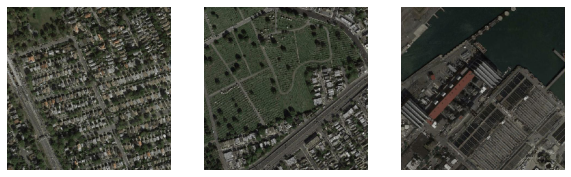

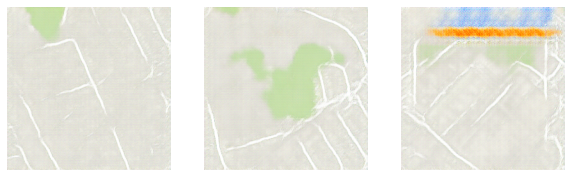

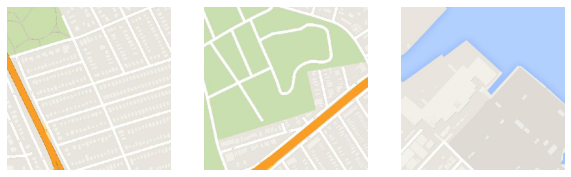

>23017, d1[0.000] d2[0.000] g[0.048]
>23018, d1[0.000] d2[0.000] g[0.063]
>23019, d1[0.000] d2[0.000] g[0.008]
>23020, d1[0.000] d2[0.000] g[0.050]
>23021, d1[0.000] d2[0.000] g[0.056]
>23022, d1[0.000] d2[0.000] g[0.065]
>23023, d1[0.000] d2[0.000] g[0.055]
>23024, d1[0.000] d2[0.000] g[0.070]
>23025, d1[0.000] d2[0.000] g[0.050]
>23026, d1[0.000] d2[0.000] g[0.065]
>23027, d1[0.000] d2[0.000] g[0.068]
>23028, d1[0.000] d2[0.000] g[0.051]
>23029, d1[0.000] d2[0.000] g[0.043]
>23030, d1[0.000] d2[0.000] g[0.086]
>23031, d1[0.000] d2[0.000] g[0.084]
>23032, d1[0.000] d2[0.000] g[0.070]
>23033, d1[0.000] d2[0.000] g[0.096]
>23034, d1[0.000] d2[0.000] g[0.052]
>23035, d1[0.000] d2[0.000] g[0.072]
>23036, d1[0.000] d2[0.000] g[0.074]
>23037, d1[0.000] d2[0.000] g[0.048]
>23038, d1[0.000] d2[0.000] g[0.071]
>23039, d1[0.000] d2[0.000] g[0.079]
>23040, d1[0.000] d2[0.000] g[0.025]
>23041, d1[0.000] d2[0.000] g[0.026]
>23042, d1[0.000] d2[0.000] g[0.052]
>23043, d1[0.000] d2[0.000] g[0.032]
>

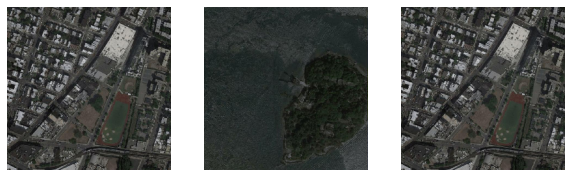

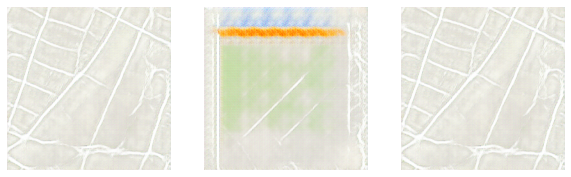

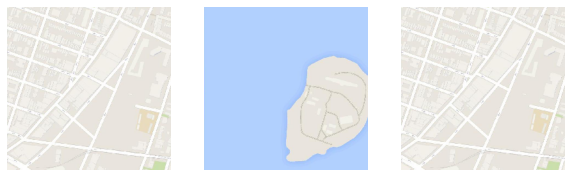

>24113, d1[0.000] d2[0.000] g[0.053]
>24114, d1[0.000] d2[0.000] g[0.089]
>24115, d1[0.000] d2[0.000] g[0.053]
>24116, d1[0.000] d2[0.000] g[0.049]
>24117, d1[0.000] d2[0.000] g[0.047]
>24118, d1[0.000] d2[0.000] g[0.057]
>24119, d1[0.000] d2[0.000] g[0.029]
>24120, d1[0.000] d2[0.000] g[0.058]
>24121, d1[0.000] d2[0.000] g[0.053]
>24122, d1[0.000] d2[0.000] g[0.075]
>24123, d1[0.000] d2[0.000] g[0.051]
>24124, d1[0.000] d2[0.000] g[0.057]
>24125, d1[0.000] d2[0.000] g[0.062]
>24126, d1[0.000] d2[0.000] g[0.093]
>24127, d1[0.000] d2[0.000] g[0.055]
>24128, d1[0.000] d2[0.000] g[0.029]
>24129, d1[0.000] d2[0.000] g[0.074]
>24130, d1[0.000] d2[0.000] g[0.056]
>24131, d1[0.000] d2[0.000] g[0.079]
>24132, d1[0.000] d2[0.000] g[0.072]
>24133, d1[0.000] d2[0.000] g[0.050]
>24134, d1[0.000] d2[0.000] g[0.020]
>24135, d1[0.000] d2[0.000] g[0.023]
>24136, d1[0.000] d2[0.000] g[0.070]
>24137, d1[0.000] d2[0.000] g[0.099]
>24138, d1[0.000] d2[0.000] g[0.083]
>24139, d1[0.000] d2[0.000] g[0.077]
>

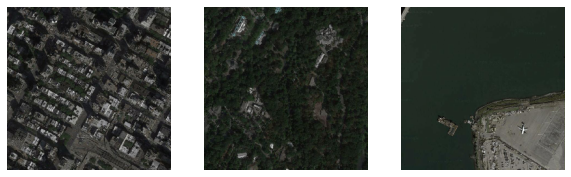

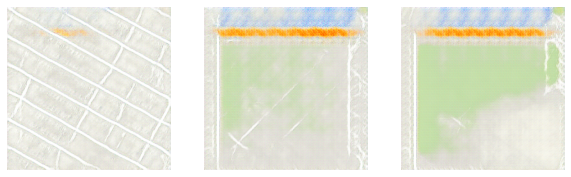

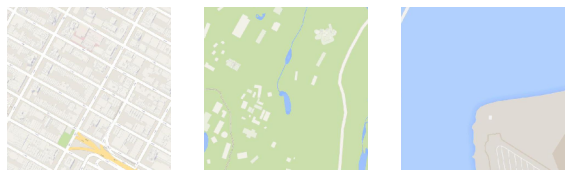

>25209, d1[0.000] d2[0.000] g[0.055]
>25210, d1[0.000] d2[0.000] g[0.049]
>25211, d1[0.000] d2[0.000] g[0.063]
>25212, d1[0.000] d2[0.000] g[0.049]
>25213, d1[0.000] d2[0.000] g[0.050]
>25214, d1[0.000] d2[0.000] g[0.025]
>25215, d1[0.000] d2[0.000] g[0.056]
>25216, d1[0.000] d2[0.000] g[0.075]
>25217, d1[0.000] d2[0.000] g[0.056]
>25218, d1[0.000] d2[0.000] g[0.056]
>25219, d1[0.000] d2[0.000] g[0.050]
>25220, d1[0.000] d2[0.000] g[0.061]
>25221, d1[0.000] d2[0.000] g[0.074]
>25222, d1[0.000] d2[0.000] g[0.078]
>25223, d1[0.000] d2[0.000] g[0.044]
>25224, d1[0.000] d2[0.000] g[0.067]
>25225, d1[0.000] d2[0.000] g[0.016]
>25226, d1[0.000] d2[0.000] g[0.048]
>25227, d1[0.000] d2[0.000] g[0.065]
>25228, d1[0.000] d2[0.000] g[0.036]
>25229, d1[0.000] d2[0.000] g[0.133]
>25230, d1[0.000] d2[0.000] g[0.246]
>25231, d1[0.000] d2[0.000] g[0.077]
>25232, d1[0.000] d2[0.000] g[0.056]
>25233, d1[0.000] d2[0.000] g[0.039]
>25234, d1[0.000] d2[0.000] g[0.154]
>25235, d1[0.000] d2[0.000] g[0.075]
>

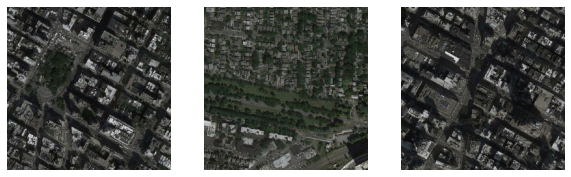

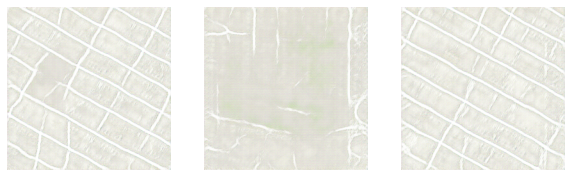

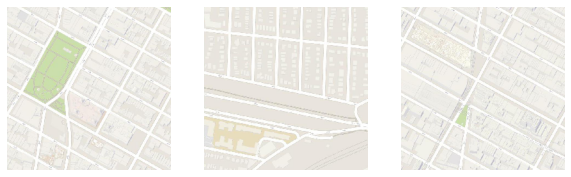

>26305, d1[0.000] d2[0.000] g[0.084]
>26306, d1[0.000] d2[0.000] g[0.057]
>26307, d1[0.000] d2[0.000] g[0.039]
>26308, d1[0.000] d2[0.000] g[0.026]
>26309, d1[0.000] d2[0.000] g[0.066]
>26310, d1[0.000] d2[0.000] g[0.048]
>26311, d1[0.000] d2[0.000] g[0.052]
>26312, d1[0.000] d2[0.000] g[0.049]
>26313, d1[0.000] d2[0.000] g[0.053]
>26314, d1[0.000] d2[0.000] g[0.043]
>26315, d1[0.000] d2[0.000] g[0.047]
>26316, d1[0.000] d2[0.000] g[0.056]
>26317, d1[0.000] d2[0.000] g[0.048]
>26318, d1[0.000] d2[0.000] g[0.062]
>26319, d1[0.000] d2[0.000] g[0.091]
>26320, d1[0.000] d2[0.000] g[0.043]
>26321, d1[0.000] d2[0.000] g[0.048]
>26322, d1[0.000] d2[0.000] g[0.069]
>26323, d1[0.000] d2[0.000] g[0.050]
>26324, d1[0.000] d2[0.000] g[0.047]
>26325, d1[0.000] d2[0.000] g[0.053]
>26326, d1[0.000] d2[0.000] g[0.064]
>26327, d1[0.000] d2[0.000] g[0.055]
>26328, d1[0.000] d2[0.000] g[0.043]
>26329, d1[0.000] d2[0.000] g[0.023]
>26330, d1[0.000] d2[0.000] g[0.055]
>26331, d1[0.000] d2[0.000] g[0.079]
>

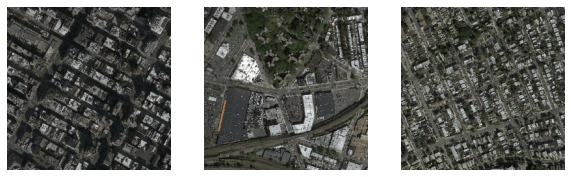

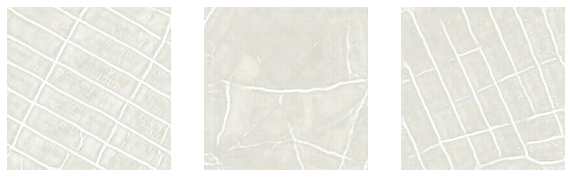

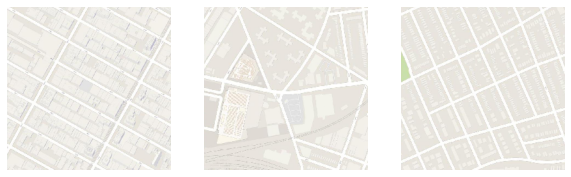

>27401, d1[0.000] d2[0.000] g[0.088]
>27402, d1[0.000] d2[0.000] g[0.037]
>27403, d1[0.000] d2[0.000] g[0.059]
>27404, d1[0.000] d2[0.000] g[0.060]
>27405, d1[0.000] d2[0.000] g[0.055]
>27406, d1[0.000] d2[0.000] g[0.047]
>27407, d1[0.000] d2[0.000] g[0.049]
>27408, d1[0.000] d2[0.000] g[0.039]
>27409, d1[0.000] d2[0.000] g[0.051]
>27410, d1[0.000] d2[0.000] g[0.044]
>27411, d1[0.000] d2[0.000] g[0.037]
>27412, d1[0.000] d2[0.000] g[0.026]
>27413, d1[0.000] d2[0.000] g[0.052]
>27414, d1[0.000] d2[0.000] g[0.049]
>27415, d1[0.000] d2[0.000] g[0.034]
>27416, d1[0.000] d2[0.000] g[0.049]
>27417, d1[0.000] d2[0.000] g[0.062]
>27418, d1[0.000] d2[0.000] g[0.052]
>27419, d1[0.000] d2[0.000] g[0.062]
>27420, d1[0.000] d2[0.000] g[0.062]
>27421, d1[0.000] d2[0.000] g[0.013]
>27422, d1[0.000] d2[0.000] g[0.045]
>27423, d1[0.000] d2[0.000] g[0.061]
>27424, d1[0.000] d2[0.000] g[0.043]
>27425, d1[0.000] d2[0.000] g[0.077]
>27426, d1[0.000] d2[0.000] g[0.080]
>27427, d1[0.000] d2[0.000] g[0.067]
>

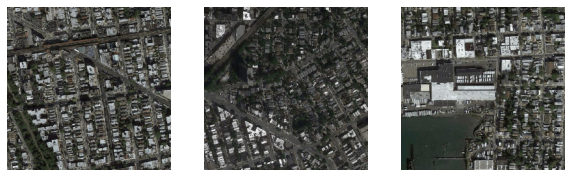

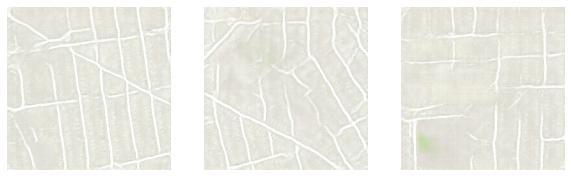

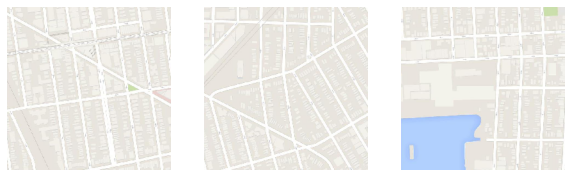

>28497, d1[0.000] d2[0.000] g[0.053]
>28498, d1[0.000] d2[0.000] g[0.037]
>28499, d1[0.000] d2[0.000] g[0.059]
>28500, d1[0.000] d2[0.000] g[0.065]
>28501, d1[0.000] d2[0.000] g[0.049]
>28502, d1[0.000] d2[0.000] g[0.071]
>28503, d1[0.000] d2[0.000] g[0.049]
>28504, d1[0.000] d2[0.000] g[0.031]
>28505, d1[0.000] d2[0.000] g[0.046]
>28506, d1[0.000] d2[0.000] g[0.057]
>28507, d1[0.000] d2[0.000] g[0.061]
>28508, d1[0.000] d2[0.000] g[0.048]
>28509, d1[0.000] d2[0.000] g[0.092]
>28510, d1[0.000] d2[0.000] g[0.045]
>28511, d1[0.000] d2[0.000] g[0.050]
>28512, d1[0.000] d2[0.000] g[0.060]
>28513, d1[0.000] d2[0.000] g[0.050]
>28514, d1[0.000] d2[0.000] g[0.086]
>28515, d1[0.000] d2[0.000] g[0.068]
>28516, d1[0.000] d2[0.000] g[0.055]
>28517, d1[0.000] d2[0.000] g[0.049]
>28518, d1[0.000] d2[0.000] g[0.051]
>28519, d1[0.000] d2[0.000] g[0.014]
>28520, d1[0.000] d2[0.000] g[0.041]
>28521, d1[0.000] d2[0.000] g[0.058]
>28522, d1[0.000] d2[0.000] g[0.049]
>28523, d1[0.000] d2[0.000] g[0.032]
>

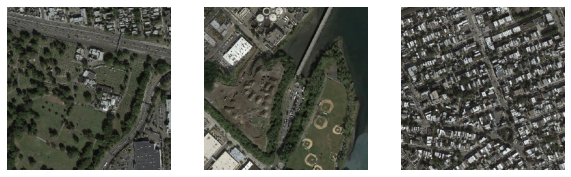

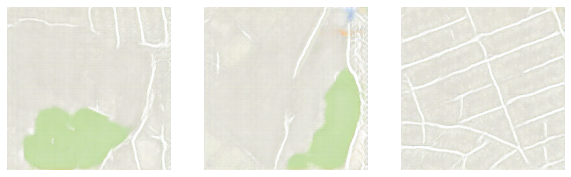

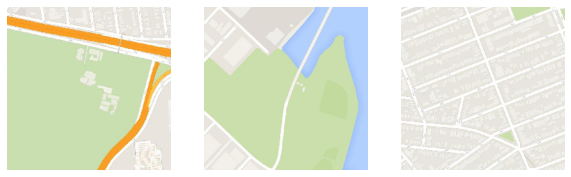

>29593, d1[0.000] d2[0.000] g[0.045]
>29594, d1[0.000] d2[0.000] g[0.050]
>29595, d1[0.000] d2[0.000] g[0.053]
>29596, d1[0.000] d2[0.000] g[0.015]
>29597, d1[0.000] d2[0.000] g[0.053]
>29598, d1[0.000] d2[0.000] g[0.076]
>29599, d1[0.000] d2[0.000] g[0.045]
>29600, d1[0.000] d2[0.000] g[0.068]
>29601, d1[0.000] d2[0.000] g[0.049]
>29602, d1[0.000] d2[0.000] g[0.014]
>29603, d1[0.000] d2[0.000] g[0.041]
>29604, d1[0.000] d2[0.000] g[0.043]
>29605, d1[0.000] d2[0.000] g[0.046]
>29606, d1[0.000] d2[0.000] g[0.053]
>29607, d1[0.000] d2[0.000] g[0.052]
>29608, d1[0.000] d2[0.000] g[0.033]
>29609, d1[0.000] d2[0.000] g[0.046]
>29610, d1[0.000] d2[0.000] g[0.048]
>29611, d1[0.000] d2[0.000] g[0.057]
>29612, d1[0.000] d2[0.000] g[0.043]
>29613, d1[0.000] d2[0.000] g[0.055]
>29614, d1[0.000] d2[0.000] g[0.044]
>29615, d1[0.000] d2[0.000] g[0.046]
>29616, d1[0.000] d2[0.000] g[0.054]
>29617, d1[0.000] d2[0.000] g[0.050]
>29618, d1[0.000] d2[0.000] g[0.061]
>29619, d1[0.000] d2[0.000] g[0.050]
>

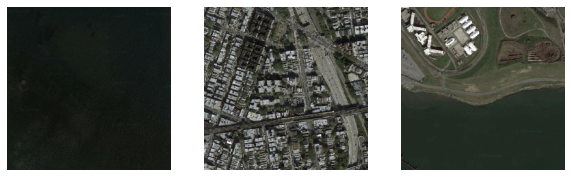

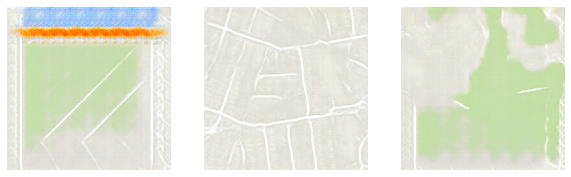

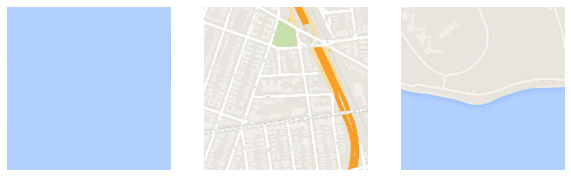

>30689, d1[0.000] d2[0.000] g[0.014]
>30690, d1[0.000] d2[0.000] g[0.047]
>30691, d1[0.000] d2[0.000] g[0.072]
>30692, d1[0.000] d2[0.000] g[0.050]
>30693, d1[0.000] d2[0.000] g[0.051]
>30694, d1[0.000] d2[0.000] g[0.068]
>30695, d1[0.000] d2[0.000] g[0.046]
>30696, d1[0.000] d2[0.000] g[0.056]
>30697, d1[0.000] d2[0.000] g[0.022]
>30698, d1[0.000] d2[0.000] g[0.025]
>30699, d1[0.000] d2[0.000] g[0.039]
>30700, d1[0.000] d2[0.000] g[0.048]
>30701, d1[0.000] d2[0.000] g[0.062]
>30702, d1[0.000] d2[0.000] g[0.017]
>30703, d1[0.000] d2[0.000] g[0.048]
>30704, d1[0.000] d2[0.000] g[0.066]
>30705, d1[0.000] d2[0.000] g[0.067]
>30706, d1[0.000] d2[0.000] g[0.037]
>30707, d1[0.000] d2[0.000] g[0.043]
>30708, d1[0.000] d2[0.000] g[0.034]
>30709, d1[0.000] d2[0.000] g[0.061]
>30710, d1[0.000] d2[0.000] g[0.049]
>30711, d1[0.000] d2[0.000] g[0.053]
>30712, d1[0.000] d2[0.000] g[0.028]
>30713, d1[0.000] d2[0.000] g[0.048]
>30714, d1[0.000] d2[0.000] g[0.026]
>30715, d1[0.000] d2[0.000] g[0.016]
>

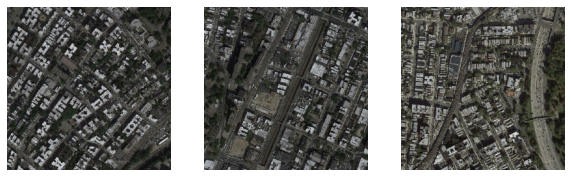

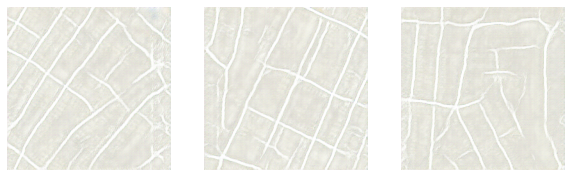

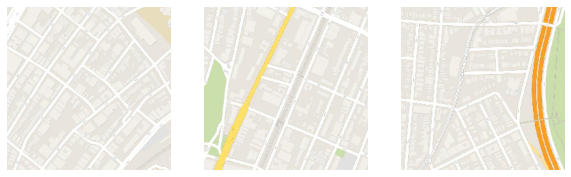

>31785, d1[0.000] d2[0.000] g[0.049]
>31786, d1[0.000] d2[0.000] g[0.049]
>31787, d1[0.000] d2[0.000] g[0.055]
>31788, d1[0.000] d2[0.000] g[0.048]
>31789, d1[0.000] d2[0.000] g[0.054]
>31790, d1[0.000] d2[0.000] g[0.045]
>31791, d1[0.000] d2[0.000] g[0.090]
>31792, d1[0.000] d2[0.000] g[0.031]
>31793, d1[0.000] d2[0.000] g[0.052]
>31794, d1[0.000] d2[0.000] g[0.061]
>31795, d1[0.000] d2[0.000] g[0.054]
>31796, d1[0.000] d2[0.000] g[0.040]
>31797, d1[0.000] d2[0.000] g[0.070]
>31798, d1[0.000] d2[0.000] g[0.050]
>31799, d1[0.000] d2[0.000] g[0.047]
>31800, d1[0.000] d2[0.000] g[0.045]
>31801, d1[0.000] d2[0.000] g[0.085]
>31802, d1[0.000] d2[0.000] g[0.020]
>31803, d1[0.000] d2[0.000] g[0.062]
>31804, d1[0.000] d2[0.000] g[0.047]
>31805, d1[0.000] d2[0.000] g[0.026]
>31806, d1[0.000] d2[0.000] g[0.037]
>31807, d1[0.000] d2[0.000] g[0.046]
>31808, d1[0.000] d2[0.000] g[0.041]
>31809, d1[0.000] d2[0.000] g[0.050]
>31810, d1[0.000] d2[0.000] g[0.128]
>31811, d1[0.000] d2[0.000] g[0.013]
>

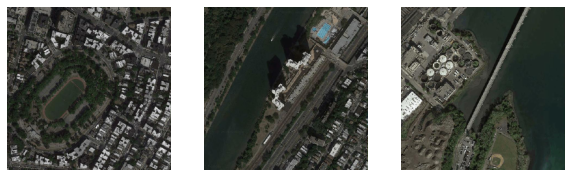

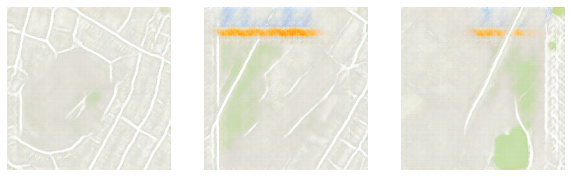

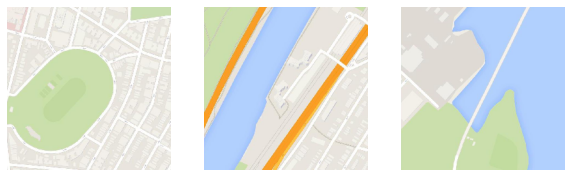

>32881, d1[0.000] d2[0.000] g[0.094]
>32882, d1[0.000] d2[0.000] g[0.044]
>32883, d1[0.000] d2[0.000] g[0.059]
>32884, d1[0.000] d2[0.000] g[0.053]
>32885, d1[0.000] d2[0.000] g[0.034]
>32886, d1[0.000] d2[0.000] g[0.049]
>32887, d1[0.000] d2[0.000] g[0.051]
>32888, d1[0.000] d2[0.000] g[0.051]
>32889, d1[0.000] d2[0.000] g[0.041]
>32890, d1[0.000] d2[0.000] g[0.046]
>32891, d1[0.000] d2[0.000] g[0.078]
>32892, d1[0.000] d2[0.000] g[0.063]
>32893, d1[0.000] d2[0.000] g[0.030]
>32894, d1[0.000] d2[0.000] g[0.055]
>32895, d1[0.000] d2[0.000] g[0.049]
>32896, d1[0.000] d2[0.000] g[0.049]
>32897, d1[0.000] d2[0.000] g[0.059]
>32898, d1[0.000] d2[0.000] g[0.048]
>32899, d1[0.000] d2[0.000] g[0.041]
>32900, d1[0.000] d2[0.000] g[0.043]
>32901, d1[0.000] d2[0.000] g[0.044]
>32902, d1[0.000] d2[0.000] g[0.061]
>32903, d1[0.000] d2[0.000] g[0.052]
>32904, d1[0.000] d2[0.000] g[0.042]
>32905, d1[0.000] d2[0.000] g[0.042]
>32906, d1[0.000] d2[0.000] g[0.048]
>32907, d1[0.000] d2[0.000] g[0.063]
>

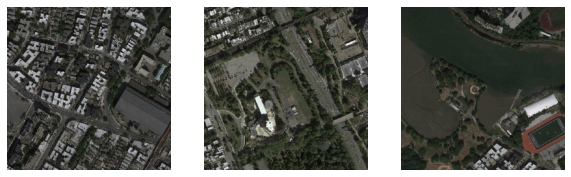

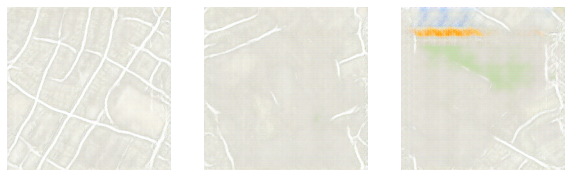

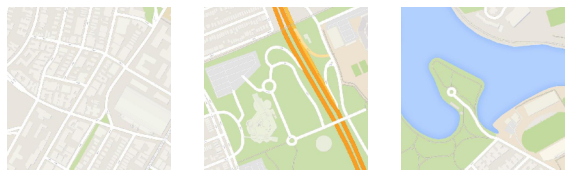

>33977, d1[0.000] d2[0.000] g[0.048]
>33978, d1[0.000] d2[0.000] g[0.065]
>33979, d1[0.000] d2[0.000] g[0.043]
>33980, d1[0.000] d2[0.000] g[0.050]
>33981, d1[0.000] d2[0.000] g[0.052]
>33982, d1[0.000] d2[0.000] g[0.051]
>33983, d1[0.000] d2[0.000] g[0.043]
>33984, d1[0.000] d2[0.000] g[0.032]
>33985, d1[0.000] d2[0.000] g[0.056]
>33986, d1[0.000] d2[0.000] g[0.043]
>33987, d1[0.000] d2[0.000] g[0.047]
>33988, d1[0.000] d2[0.000] g[0.040]
>33989, d1[0.000] d2[0.000] g[0.029]
>33990, d1[0.000] d2[0.000] g[0.031]
>33991, d1[0.000] d2[0.000] g[0.020]
>33992, d1[0.000] d2[0.000] g[0.058]
>33993, d1[0.000] d2[0.000] g[0.047]
>33994, d1[0.000] d2[0.000] g[0.061]
>33995, d1[0.000] d2[0.000] g[0.046]
>33996, d1[0.000] d2[0.000] g[0.044]
>33997, d1[0.000] d2[0.000] g[0.063]
>33998, d1[0.000] d2[0.000] g[0.049]
>33999, d1[0.000] d2[0.000] g[0.041]
>34000, d1[0.000] d2[0.000] g[0.056]
>34001, d1[0.000] d2[0.000] g[0.096]
>34002, d1[0.000] d2[0.000] g[0.062]
>34003, d1[0.000] d2[0.000] g[0.044]
>

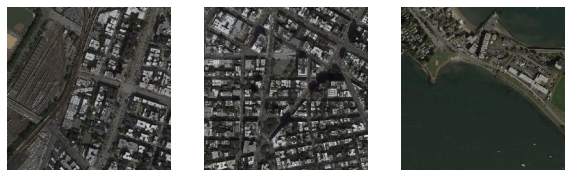

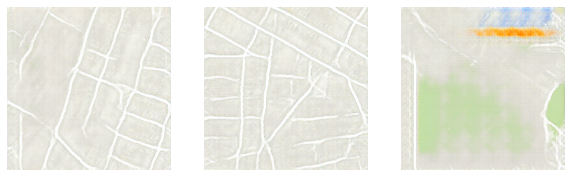

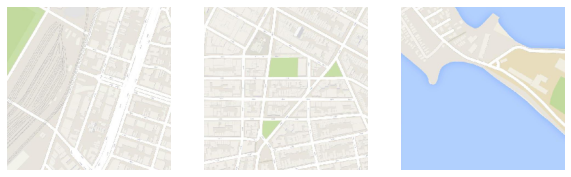

>35073, d1[0.000] d2[0.000] g[0.048]
>35074, d1[0.000] d2[0.000] g[0.050]
>35075, d1[0.000] d2[0.000] g[0.056]
>35076, d1[0.000] d2[0.000] g[0.033]
>35077, d1[0.000] d2[0.000] g[0.047]
>35078, d1[0.000] d2[0.000] g[0.045]
>35079, d1[0.000] d2[0.000] g[0.056]
>35080, d1[0.000] d2[0.000] g[0.059]
>35081, d1[0.000] d2[0.000] g[0.040]
>35082, d1[0.000] d2[0.000] g[0.055]
>35083, d1[0.000] d2[0.000] g[0.046]
>35084, d1[0.000] d2[0.000] g[0.012]
>35085, d1[0.000] d2[0.000] g[0.124]
>35086, d1[0.000] d2[0.000] g[0.048]
>35087, d1[0.000] d2[0.000] g[0.040]
>35088, d1[0.000] d2[0.000] g[0.044]
>35089, d1[0.000] d2[0.000] g[0.042]
>35090, d1[0.000] d2[0.000] g[0.045]
>35091, d1[0.000] d2[0.000] g[0.038]
>35092, d1[0.000] d2[0.000] g[0.028]
>35093, d1[0.000] d2[0.000] g[0.046]
>35094, d1[0.000] d2[0.000] g[0.044]
>35095, d1[0.000] d2[0.000] g[0.039]
>35096, d1[0.000] d2[0.000] g[0.050]
>35097, d1[0.000] d2[0.000] g[0.060]
>35098, d1[0.000] d2[0.000] g[0.041]
>35099, d1[0.000] d2[0.000] g[0.025]
>

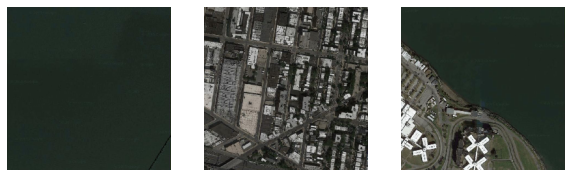

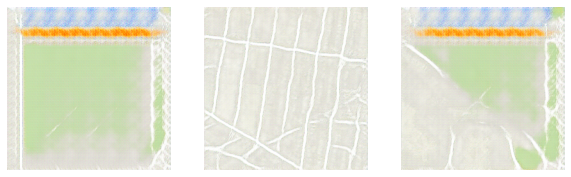

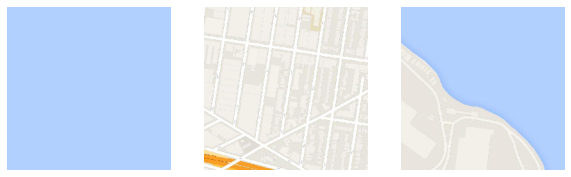

>36169, d1[0.000] d2[0.000] g[0.041]
>36170, d1[0.000] d2[0.000] g[0.031]
>36171, d1[0.000] d2[0.000] g[0.044]
>36172, d1[0.000] d2[0.000] g[0.045]
>36173, d1[0.000] d2[0.000] g[0.056]
>36174, d1[0.000] d2[0.000] g[0.042]
>36175, d1[0.000] d2[0.000] g[0.052]
>36176, d1[0.000] d2[0.000] g[0.046]
>36177, d1[0.000] d2[0.000] g[0.053]
>36178, d1[0.000] d2[0.000] g[0.034]
>36179, d1[0.000] d2[0.000] g[0.020]
>36180, d1[0.000] d2[0.000] g[0.045]
>36181, d1[0.000] d2[0.000] g[0.066]
>36182, d1[0.000] d2[0.000] g[0.044]
>36183, d1[0.000] d2[0.000] g[0.047]
>36184, d1[0.000] d2[0.000] g[0.039]
>36185, d1[0.000] d2[0.000] g[0.044]
>36186, d1[0.000] d2[0.000] g[0.046]
>36187, d1[0.000] d2[0.000] g[0.029]
>36188, d1[0.000] d2[0.000] g[0.009]
>36189, d1[0.000] d2[0.000] g[0.040]
>36190, d1[0.000] d2[0.000] g[0.007]
>36191, d1[0.000] d2[0.000] g[0.038]
>36192, d1[0.000] d2[0.000] g[0.044]
>36193, d1[0.000] d2[0.000] g[0.041]
>36194, d1[0.000] d2[0.000] g[0.044]
>36195, d1[0.000] d2[0.000] g[0.028]
>

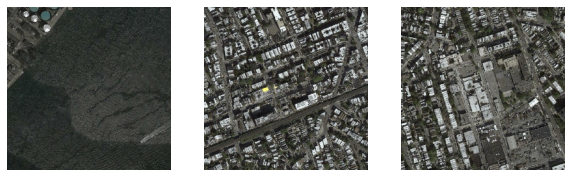

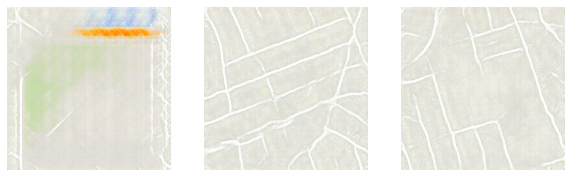

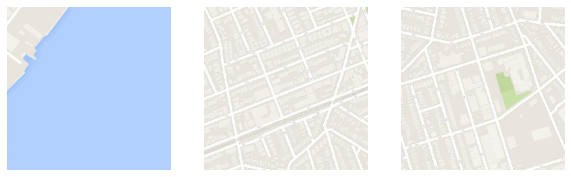

>37265, d1[0.000] d2[0.000] g[0.034]
>37266, d1[0.000] d2[0.000] g[0.040]
>37267, d1[0.000] d2[0.000] g[0.045]
>37268, d1[0.000] d2[0.000] g[0.076]
>37269, d1[0.000] d2[0.000] g[0.039]
>37270, d1[0.000] d2[0.000] g[0.061]
>37271, d1[0.000] d2[0.000] g[0.054]
>37272, d1[0.000] d2[0.000] g[0.034]
>37273, d1[0.000] d2[0.000] g[0.035]
>37274, d1[0.000] d2[0.000] g[0.063]
>37275, d1[0.000] d2[0.000] g[0.043]
>37276, d1[0.000] d2[0.000] g[0.047]
>37277, d1[0.000] d2[0.000] g[0.043]
>37278, d1[0.000] d2[0.000] g[0.041]
>37279, d1[0.000] d2[0.000] g[0.047]
>37280, d1[0.000] d2[0.000] g[0.025]
>37281, d1[0.000] d2[0.000] g[0.052]
>37282, d1[0.000] d2[0.000] g[0.054]
>37283, d1[0.000] d2[0.000] g[0.032]
>37284, d1[0.000] d2[0.000] g[0.065]
>37285, d1[0.000] d2[0.000] g[0.054]
>37286, d1[0.000] d2[0.000] g[0.010]
>37287, d1[0.000] d2[0.000] g[0.046]
>37288, d1[0.000] d2[0.000] g[0.041]
>37289, d1[0.000] d2[0.000] g[0.069]
>37290, d1[0.000] d2[0.000] g[0.045]
>37291, d1[0.000] d2[0.000] g[0.033]
>

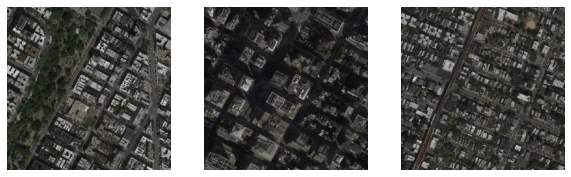

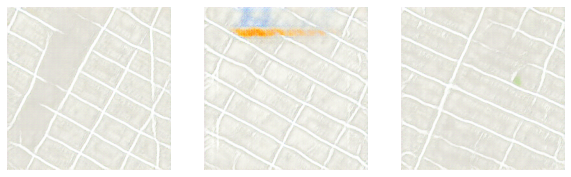

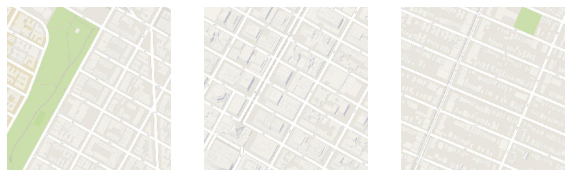

>38361, d1[0.000] d2[0.000] g[0.043]
>38362, d1[0.000] d2[0.000] g[0.053]
>38363, d1[0.000] d2[0.000] g[0.036]
>38364, d1[0.000] d2[0.000] g[0.038]
>38365, d1[0.000] d2[0.000] g[0.059]
>38366, d1[0.000] d2[0.000] g[0.011]
>38367, d1[0.000] d2[0.000] g[0.069]
>38368, d1[0.000] d2[0.000] g[0.048]
>38369, d1[0.000] d2[0.000] g[0.022]
>38370, d1[0.000] d2[0.000] g[0.041]
>38371, d1[0.000] d2[0.000] g[0.035]
>38372, d1[0.000] d2[0.000] g[0.077]
>38373, d1[0.000] d2[0.000] g[0.050]
>38374, d1[0.000] d2[0.000] g[0.037]
>38375, d1[0.000] d2[0.000] g[0.035]
>38376, d1[0.000] d2[0.000] g[0.057]
>38377, d1[0.000] d2[0.000] g[0.043]
>38378, d1[0.000] d2[0.000] g[0.047]
>38379, d1[0.000] d2[0.000] g[0.085]
>38380, d1[0.000] d2[0.000] g[0.045]
>38381, d1[0.000] d2[0.000] g[0.047]
>38382, d1[0.000] d2[0.000] g[0.048]
>38383, d1[0.000] d2[0.000] g[0.048]
>38384, d1[0.000] d2[0.000] g[0.043]
>38385, d1[0.000] d2[0.000] g[0.009]
>38386, d1[0.000] d2[0.000] g[0.034]
>38387, d1[0.000] d2[0.000] g[0.044]
>

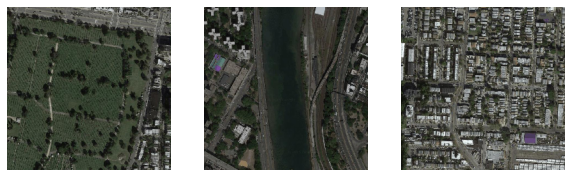

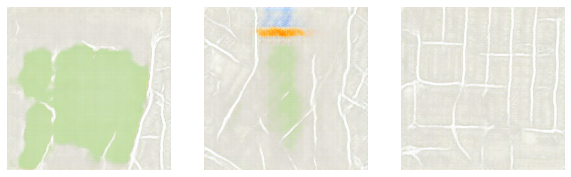

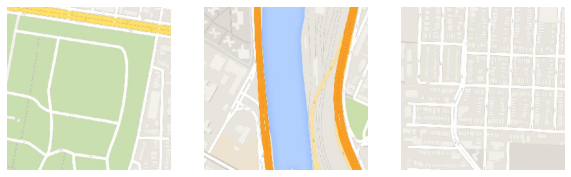

>39457, d1[0.000] d2[0.000] g[0.059]
>39458, d1[0.000] d2[0.000] g[0.051]
>39459, d1[0.000] d2[0.000] g[0.058]
>39460, d1[0.000] d2[0.000] g[0.006]
>39461, d1[0.000] d2[0.000] g[0.042]
>39462, d1[0.000] d2[0.000] g[0.028]
>39463, d1[0.000] d2[0.000] g[0.009]
>39464, d1[0.000] d2[0.000] g[0.051]
>39465, d1[0.000] d2[0.000] g[0.011]
>39466, d1[0.000] d2[0.000] g[0.056]
>39467, d1[0.000] d2[0.000] g[0.037]
>39468, d1[0.000] d2[0.000] g[0.036]
>39469, d1[0.000] d2[0.000] g[0.043]
>39470, d1[0.000] d2[0.000] g[0.011]
>39471, d1[0.000] d2[0.000] g[0.041]
>39472, d1[0.000] d2[0.000] g[0.019]
>39473, d1[0.000] d2[0.000] g[0.034]
>39474, d1[0.000] d2[0.000] g[0.028]
>39475, d1[0.000] d2[0.000] g[0.021]
>39476, d1[0.000] d2[0.000] g[0.045]
>39477, d1[0.000] d2[0.000] g[0.042]
>39478, d1[0.000] d2[0.000] g[0.007]
>39479, d1[0.000] d2[0.000] g[0.044]
>39480, d1[0.000] d2[0.000] g[0.035]
>39481, d1[0.000] d2[0.000] g[0.053]
>39482, d1[0.000] d2[0.000] g[0.039]
>39483, d1[0.000] d2[0.000] g[0.023]
>

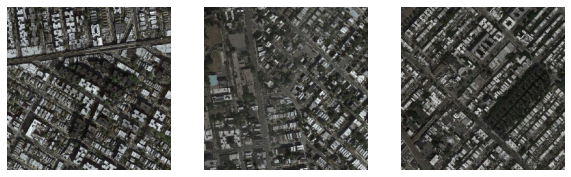

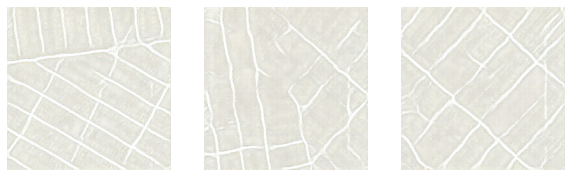

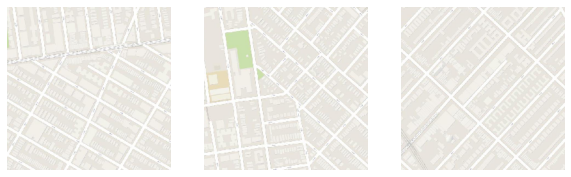

>40553, d1[0.000] d2[0.000] g[0.045]
>40554, d1[0.000] d2[0.000] g[0.035]
>40555, d1[0.000] d2[0.000] g[0.048]
>40556, d1[0.000] d2[0.000] g[0.072]
>40557, d1[0.000] d2[0.000] g[0.046]
>40558, d1[0.000] d2[0.000] g[0.049]
>40559, d1[0.000] d2[0.000] g[0.047]
>40560, d1[0.000] d2[0.000] g[0.035]
>40561, d1[0.000] d2[0.000] g[0.067]
>40562, d1[0.000] d2[0.000] g[0.029]
>40563, d1[0.000] d2[0.000] g[0.051]
>40564, d1[0.000] d2[0.000] g[0.057]
>40565, d1[0.000] d2[0.000] g[0.050]
>40566, d1[0.000] d2[0.000] g[0.046]
>40567, d1[0.000] d2[0.000] g[0.080]
>40568, d1[0.000] d2[0.000] g[0.027]
>40569, d1[0.000] d2[0.000] g[0.046]
>40570, d1[0.000] d2[0.000] g[0.041]
>40571, d1[0.000] d2[0.000] g[0.041]
>40572, d1[0.000] d2[0.000] g[0.033]
>40573, d1[0.000] d2[0.000] g[0.050]
>40574, d1[0.000] d2[0.000] g[0.036]
>40575, d1[0.000] d2[0.000] g[0.045]
>40576, d1[0.000] d2[0.000] g[0.044]
>40577, d1[0.000] d2[0.000] g[0.043]
>40578, d1[0.000] d2[0.000] g[0.052]
>40579, d1[0.000] d2[0.000] g[0.052]
>

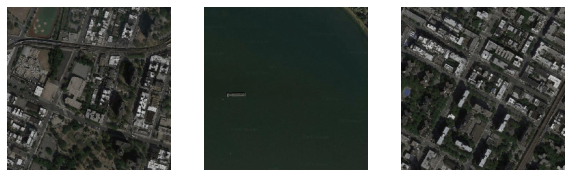

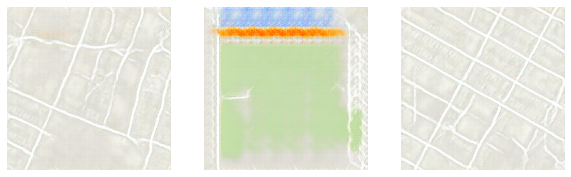

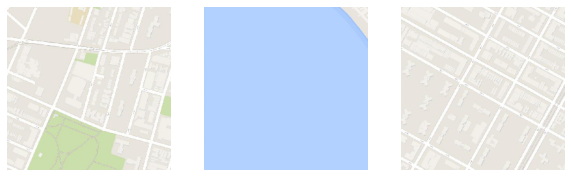

>41649, d1[0.000] d2[0.000] g[0.026]
>41650, d1[0.000] d2[0.000] g[0.051]
>41651, d1[0.000] d2[0.000] g[0.041]
>41652, d1[0.000] d2[0.000] g[0.064]
>41653, d1[0.000] d2[0.000] g[0.040]
>41654, d1[0.000] d2[0.000] g[0.022]
>41655, d1[0.000] d2[0.000] g[0.042]
>41656, d1[0.000] d2[0.000] g[0.050]
>41657, d1[0.000] d2[0.000] g[0.047]
>41658, d1[0.000] d2[0.000] g[0.063]
>41659, d1[0.000] d2[0.000] g[0.081]
>41660, d1[0.000] d2[0.000] g[0.051]
>41661, d1[0.000] d2[0.000] g[0.039]
>41662, d1[0.000] d2[0.000] g[0.049]
>41663, d1[0.000] d2[0.000] g[0.054]
>41664, d1[0.000] d2[0.000] g[0.052]
>41665, d1[0.000] d2[0.000] g[0.046]
>41666, d1[0.000] d2[0.000] g[0.046]
>41667, d1[0.000] d2[0.000] g[0.054]
>41668, d1[0.000] d2[0.000] g[0.038]
>41669, d1[0.000] d2[0.000] g[0.041]
>41670, d1[0.000] d2[0.000] g[0.057]
>41671, d1[0.000] d2[0.000] g[0.047]
>41672, d1[0.000] d2[0.000] g[0.044]
>41673, d1[0.000] d2[0.000] g[0.056]
>41674, d1[0.000] d2[0.000] g[0.044]
>41675, d1[0.000] d2[0.000] g[0.015]
>

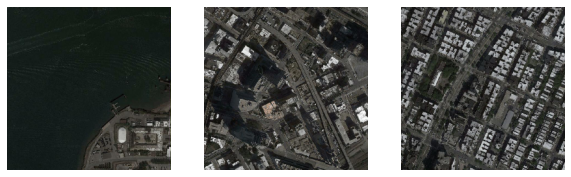

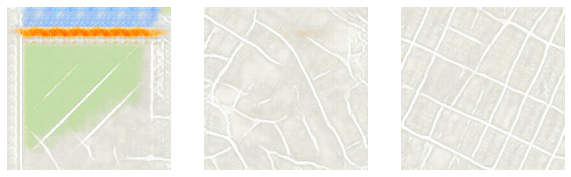

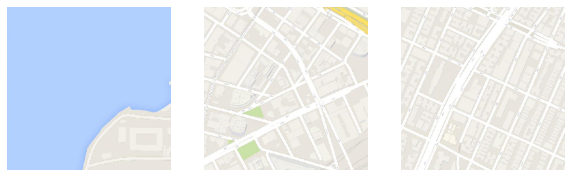

>42745, d1[0.000] d2[0.000] g[0.038]
>42746, d1[0.000] d2[0.000] g[0.033]
>42747, d1[0.000] d2[0.000] g[0.051]
>42748, d1[0.000] d2[0.000] g[0.039]
>42749, d1[0.000] d2[0.000] g[0.037]
>42750, d1[0.000] d2[0.000] g[0.070]
>42751, d1[0.000] d2[0.000] g[0.037]
>42752, d1[0.000] d2[0.000] g[0.008]
>42753, d1[0.000] d2[0.000] g[0.029]
>42754, d1[0.000] d2[0.000] g[0.049]
>42755, d1[0.000] d2[0.000] g[0.043]
>42756, d1[0.000] d2[0.000] g[0.045]
>42757, d1[0.000] d2[0.000] g[0.051]
>42758, d1[0.000] d2[0.000] g[0.035]
>42759, d1[0.000] d2[0.000] g[0.059]
>42760, d1[0.000] d2[0.000] g[0.049]
>42761, d1[0.000] d2[0.000] g[0.039]
>42762, d1[0.000] d2[0.000] g[0.044]
>42763, d1[0.000] d2[0.000] g[0.046]
>42764, d1[0.000] d2[0.000] g[0.039]
>42765, d1[0.000] d2[0.000] g[0.007]
>42766, d1[0.000] d2[0.000] g[0.034]
>42767, d1[0.000] d2[0.000] g[0.044]
>42768, d1[0.000] d2[0.000] g[0.053]
>42769, d1[0.000] d2[0.000] g[0.035]
>42770, d1[0.000] d2[0.000] g[0.062]
>42771, d1[0.000] d2[0.000] g[0.020]
>

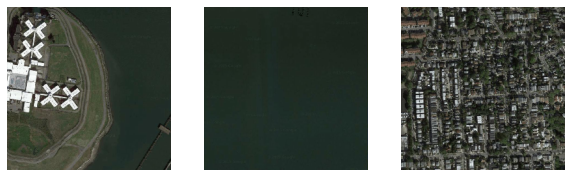

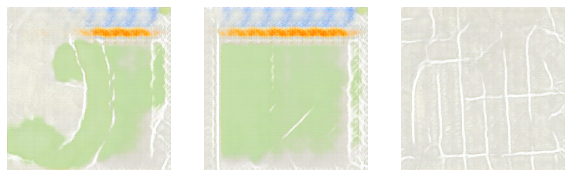

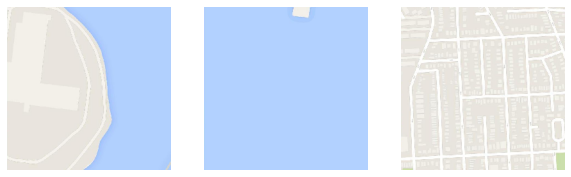

>43841, d1[0.000] d2[0.000] g[0.033]
>43842, d1[0.000] d2[0.000] g[0.044]
>43843, d1[0.000] d2[0.000] g[0.036]
>43844, d1[0.000] d2[0.000] g[0.026]
>43845, d1[0.000] d2[0.000] g[0.025]
>43846, d1[0.000] d2[0.000] g[0.051]
>43847, d1[0.000] d2[0.000] g[0.043]
>43848, d1[0.000] d2[0.000] g[0.043]
>43849, d1[0.000] d2[0.000] g[0.052]
>43850, d1[0.000] d2[0.000] g[0.042]
>43851, d1[0.000] d2[0.000] g[0.039]
>43852, d1[0.000] d2[0.000] g[0.051]
>43853, d1[0.000] d2[0.000] g[0.043]
>43854, d1[0.000] d2[0.000] g[0.039]
>43855, d1[0.000] d2[0.000] g[0.043]
>43856, d1[0.000] d2[0.000] g[0.045]
>43857, d1[0.000] d2[0.000] g[0.023]
>43858, d1[0.000] d2[0.000] g[0.048]
>43859, d1[0.000] d2[0.000] g[0.041]
>43860, d1[0.000] d2[0.000] g[0.031]
>43861, d1[0.000] d2[0.000] g[0.044]
>43862, d1[0.000] d2[0.000] g[0.048]
>43863, d1[0.000] d2[0.000] g[0.041]
>43864, d1[0.000] d2[0.000] g[0.009]
>43865, d1[0.000] d2[0.000] g[0.025]
>43866, d1[0.000] d2[0.000] g[0.063]
>43867, d1[0.000] d2[0.000] g[0.044]
>

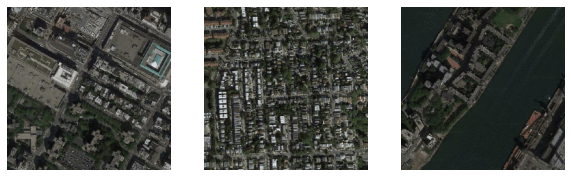

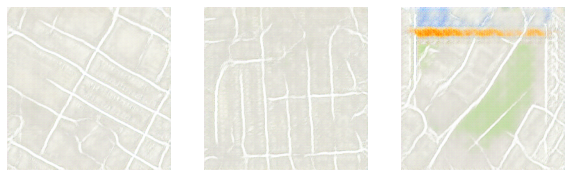

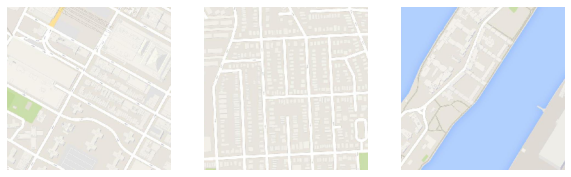

>44937, d1[0.000] d2[0.000] g[0.053]
>44938, d1[0.000] d2[0.000] g[0.056]
>44939, d1[0.000] d2[0.000] g[0.009]
>44940, d1[0.000] d2[0.000] g[0.030]
>44941, d1[0.000] d2[0.000] g[0.039]
>44942, d1[0.000] d2[0.000] g[0.071]
>44943, d1[0.000] d2[0.000] g[0.013]
>44944, d1[0.000] d2[0.000] g[0.061]
>44945, d1[0.000] d2[0.000] g[0.046]
>44946, d1[0.000] d2[0.000] g[0.053]
>44947, d1[0.000] d2[0.000] g[0.046]
>44948, d1[0.000] d2[0.000] g[0.045]
>44949, d1[0.000] d2[0.000] g[0.035]
>44950, d1[0.000] d2[0.000] g[0.045]
>44951, d1[0.000] d2[0.000] g[0.040]
>44952, d1[0.000] d2[0.000] g[0.035]
>44953, d1[0.000] d2[0.000] g[0.030]
>44954, d1[0.000] d2[0.000] g[0.044]
>44955, d1[0.000] d2[0.000] g[0.045]
>44956, d1[0.000] d2[0.000] g[0.054]
>44957, d1[0.000] d2[0.000] g[0.045]
>44958, d1[0.000] d2[0.000] g[0.041]
>44959, d1[0.000] d2[0.000] g[0.023]
>44960, d1[0.000] d2[0.000] g[0.038]
>44961, d1[0.000] d2[0.000] g[0.011]
>44962, d1[0.000] d2[0.000] g[0.042]
>44963, d1[0.000] d2[0.000] g[0.043]
>

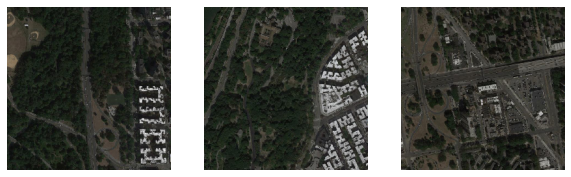

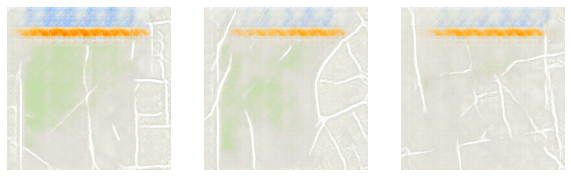

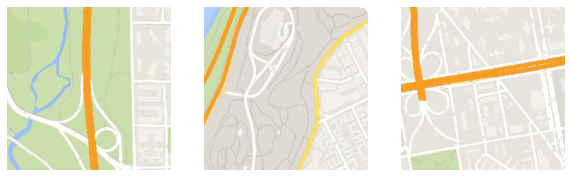

>46033, d1[0.000] d2[0.000] g[0.021]
>46034, d1[0.000] d2[0.000] g[0.038]
>46035, d1[0.000] d2[0.000] g[0.042]
>46036, d1[0.000] d2[0.000] g[0.046]
>46037, d1[0.000] d2[0.000] g[0.067]
>46038, d1[0.000] d2[0.000] g[0.041]
>46039, d1[0.000] d2[0.000] g[0.038]
>46040, d1[0.000] d2[0.000] g[0.034]
>46041, d1[0.000] d2[0.000] g[0.034]
>46042, d1[0.000] d2[0.000] g[0.022]
>46043, d1[0.000] d2[0.000] g[0.040]
>46044, d1[0.000] d2[0.000] g[0.043]
>46045, d1[0.000] d2[0.000] g[0.047]
>46046, d1[0.000] d2[0.000] g[0.047]
>46047, d1[0.000] d2[0.000] g[0.009]
>46048, d1[0.000] d2[0.000] g[0.040]
>46049, d1[0.000] d2[0.000] g[0.044]
>46050, d1[0.000] d2[0.000] g[0.040]
>46051, d1[0.000] d2[0.000] g[0.033]
>46052, d1[0.000] d2[0.000] g[0.045]
>46053, d1[0.000] d2[0.000] g[0.041]
>46054, d1[0.000] d2[0.000] g[0.039]
>46055, d1[0.000] d2[0.000] g[0.038]
>46056, d1[0.000] d2[0.000] g[0.022]
>46057, d1[0.000] d2[0.000] g[0.043]
>46058, d1[0.000] d2[0.000] g[0.044]
>46059, d1[0.000] d2[0.000] g[0.041]
>

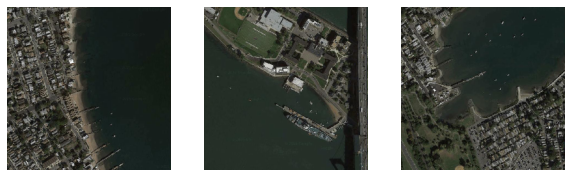

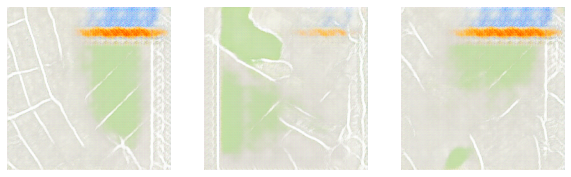

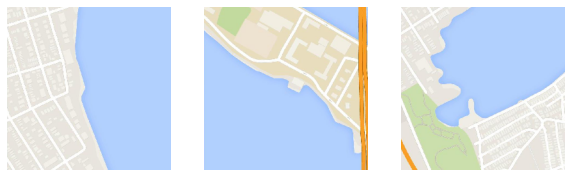

>47129, d1[0.000] d2[0.000] g[0.048]
>47130, d1[0.000] d2[0.000] g[0.037]
>47131, d1[0.000] d2[0.000] g[0.037]
>47132, d1[0.000] d2[0.000] g[0.018]
>47133, d1[0.000] d2[0.000] g[0.031]
>47134, d1[0.000] d2[0.000] g[0.049]
>47135, d1[0.000] d2[0.000] g[0.013]
>47136, d1[0.000] d2[0.000] g[0.040]
>47137, d1[0.000] d2[0.000] g[0.024]
>47138, d1[0.000] d2[0.000] g[0.037]
>47139, d1[0.000] d2[0.000] g[0.034]
>47140, d1[0.000] d2[0.000] g[0.039]
>47141, d1[0.000] d2[0.000] g[0.046]
>47142, d1[0.000] d2[0.000] g[0.039]
>47143, d1[0.000] d2[0.000] g[0.018]
>47144, d1[0.000] d2[0.000] g[0.042]
>47145, d1[0.000] d2[0.000] g[0.049]
>47146, d1[0.000] d2[0.000] g[0.061]
>47147, d1[0.000] d2[0.000] g[0.051]
>47148, d1[0.000] d2[0.000] g[0.033]
>47149, d1[0.000] d2[0.000] g[0.042]
>47150, d1[0.000] d2[0.000] g[0.044]
>47151, d1[0.000] d2[0.000] g[0.030]
>47152, d1[0.000] d2[0.000] g[0.043]
>47153, d1[0.000] d2[0.000] g[0.017]
>47154, d1[0.000] d2[0.000] g[0.025]
>47155, d1[0.000] d2[0.000] g[0.044]
>

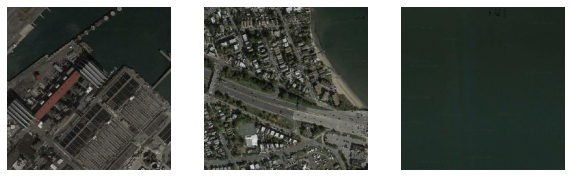

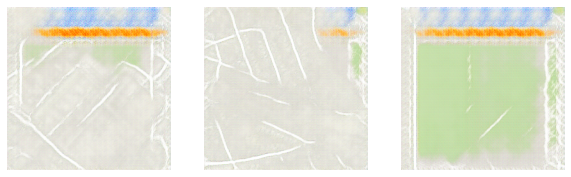

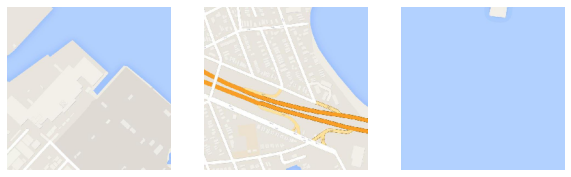

>48225, d1[0.000] d2[0.000] g[0.034]
>48226, d1[0.000] d2[0.000] g[0.009]
>48227, d1[0.000] d2[0.000] g[0.033]
>48228, d1[0.000] d2[0.000] g[0.037]
>48229, d1[0.000] d2[0.000] g[0.042]
>48230, d1[0.000] d2[0.000] g[0.046]
>48231, d1[0.000] d2[0.000] g[0.033]
>48232, d1[0.000] d2[0.000] g[0.034]
>48233, d1[0.000] d2[0.000] g[0.038]
>48234, d1[0.000] d2[0.000] g[0.040]
>48235, d1[0.000] d2[0.000] g[0.062]
>48236, d1[0.000] d2[0.000] g[0.047]
>48237, d1[0.000] d2[0.000] g[0.018]
>48238, d1[0.000] d2[0.000] g[0.060]
>48239, d1[0.000] d2[0.000] g[0.060]
>48240, d1[0.000] d2[0.000] g[0.045]
>48241, d1[0.000] d2[0.000] g[0.042]
>48242, d1[0.000] d2[0.000] g[0.009]
>48243, d1[0.000] d2[0.000] g[0.034]
>48244, d1[0.000] d2[0.000] g[0.051]
>48245, d1[0.000] d2[0.000] g[0.045]
>48246, d1[0.000] d2[0.000] g[0.041]
>48247, d1[0.000] d2[0.000] g[0.053]
>48248, d1[0.000] d2[0.000] g[0.018]
>48249, d1[0.000] d2[0.000] g[0.034]
>48250, d1[0.000] d2[0.000] g[0.026]
>48251, d1[0.000] d2[0.000] g[0.038]
>

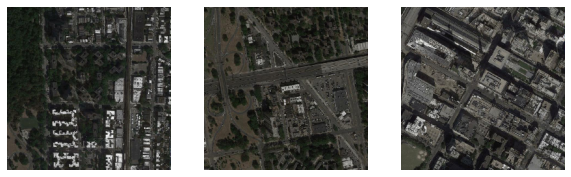

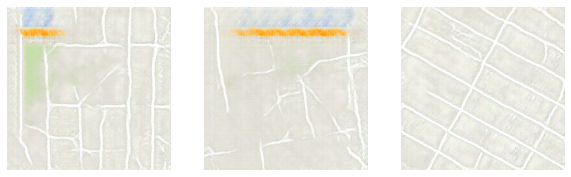

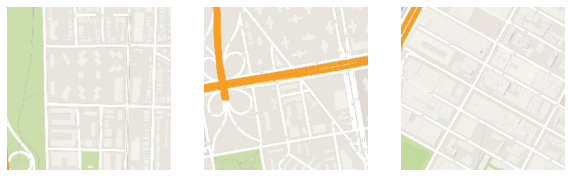

>49321, d1[0.000] d2[0.000] g[0.046]
>49322, d1[0.000] d2[0.000] g[0.047]
>49323, d1[0.000] d2[0.000] g[0.012]
>49324, d1[0.000] d2[0.000] g[0.046]
>49325, d1[0.000] d2[0.000] g[0.065]
>49326, d1[0.000] d2[0.000] g[0.044]
>49327, d1[0.000] d2[0.000] g[0.037]
>49328, d1[0.000] d2[0.000] g[0.042]
>49329, d1[0.000] d2[0.000] g[0.033]
>49330, d1[0.000] d2[0.000] g[0.021]
>49331, d1[0.000] d2[0.000] g[0.009]
>49332, d1[0.000] d2[0.000] g[0.039]
>49333, d1[0.000] d2[0.000] g[0.069]
>49334, d1[0.000] d2[0.000] g[0.058]
>49335, d1[0.000] d2[0.000] g[0.032]
>49336, d1[0.000] d2[0.000] g[0.036]
>49337, d1[0.000] d2[0.000] g[0.034]
>49338, d1[0.000] d2[0.000] g[0.047]
>49339, d1[0.000] d2[0.000] g[0.033]
>49340, d1[0.000] d2[0.000] g[0.042]
>49341, d1[0.000] d2[0.000] g[0.006]
>49342, d1[0.000] d2[0.000] g[0.057]
>49343, d1[0.000] d2[0.000] g[0.031]
>49344, d1[0.000] d2[0.000] g[0.039]
>49345, d1[0.000] d2[0.000] g[0.048]
>49346, d1[0.000] d2[0.000] g[0.040]
>49347, d1[0.000] d2[0.000] g[0.040]
>

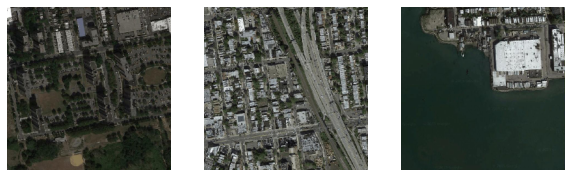

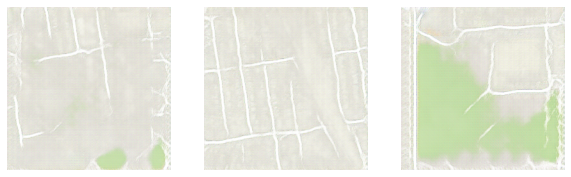

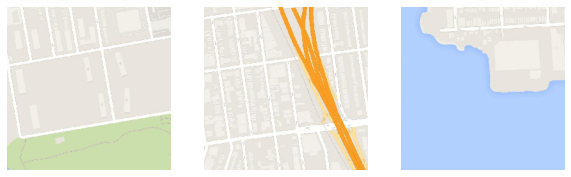

>50417, d1[0.000] d2[0.000] g[0.031]
>50418, d1[0.000] d2[0.000] g[0.031]
>50419, d1[0.000] d2[0.000] g[0.040]
>50420, d1[0.000] d2[0.000] g[0.038]
>50421, d1[0.000] d2[0.000] g[0.042]
>50422, d1[0.000] d2[0.000] g[0.037]
>50423, d1[0.000] d2[0.000] g[0.028]
>50424, d1[0.000] d2[0.000] g[0.037]
>50425, d1[0.000] d2[0.000] g[0.049]
>50426, d1[0.000] d2[0.000] g[0.044]
>50427, d1[0.000] d2[0.000] g[0.034]
>50428, d1[0.000] d2[0.000] g[0.032]
>50429, d1[0.000] d2[0.000] g[0.042]
>50430, d1[0.000] d2[0.000] g[0.029]
>50431, d1[0.000] d2[0.000] g[0.045]
>50432, d1[0.000] d2[0.000] g[0.045]
>50433, d1[0.000] d2[0.000] g[0.037]
>50434, d1[0.000] d2[0.000] g[0.045]
>50435, d1[0.000] d2[0.000] g[0.039]
>50436, d1[0.000] d2[0.000] g[0.025]
>50437, d1[0.000] d2[0.000] g[0.047]
>50438, d1[0.000] d2[0.000] g[0.065]
>50439, d1[0.000] d2[0.000] g[0.040]
>50440, d1[0.000] d2[0.000] g[0.036]
>50441, d1[0.000] d2[0.000] g[0.046]
>50442, d1[0.000] d2[0.000] g[0.040]
>50443, d1[0.000] d2[0.000] g[0.013]
>

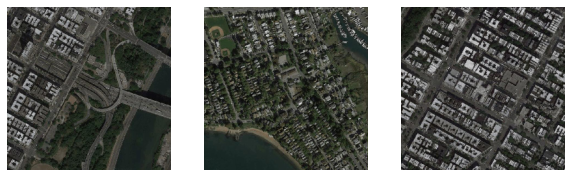

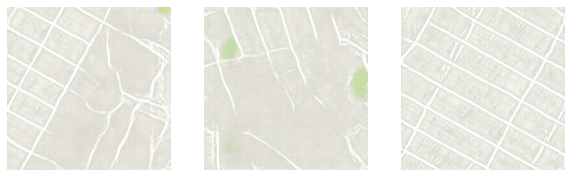

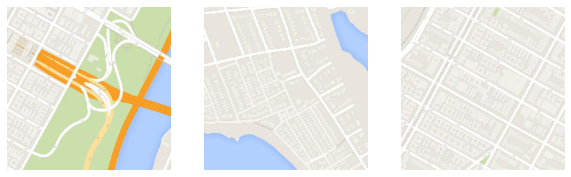

>51513, d1[0.000] d2[0.000] g[0.081]
>51514, d1[0.000] d2[0.000] g[0.019]
>51515, d1[0.000] d2[0.000] g[0.041]
>51516, d1[0.000] d2[0.000] g[0.036]
>51517, d1[0.000] d2[0.000] g[0.034]
>51518, d1[0.000] d2[0.000] g[0.048]
>51519, d1[0.000] d2[0.000] g[0.048]
>51520, d1[0.000] d2[0.000] g[0.033]
>51521, d1[0.000] d2[0.000] g[0.026]
>51522, d1[0.000] d2[0.000] g[0.018]
>51523, d1[0.000] d2[0.000] g[0.037]
>51524, d1[0.000] d2[0.000] g[0.040]
>51525, d1[0.000] d2[0.000] g[0.044]
>51526, d1[0.000] d2[0.000] g[0.085]
>51527, d1[0.000] d2[0.000] g[0.034]
>51528, d1[0.000] d2[0.000] g[0.044]
>51529, d1[0.000] d2[0.000] g[0.037]
>51530, d1[0.000] d2[0.000] g[0.033]
>51531, d1[0.000] d2[0.000] g[0.029]
>51532, d1[0.000] d2[0.000] g[0.034]
>51533, d1[0.000] d2[0.000] g[0.039]
>51534, d1[0.000] d2[0.000] g[0.035]
>51535, d1[0.000] d2[0.000] g[0.049]
>51536, d1[0.000] d2[0.000] g[0.044]
>51537, d1[0.000] d2[0.000] g[0.039]
>51538, d1[0.000] d2[0.000] g[0.027]
>51539, d1[0.000] d2[0.000] g[0.018]
>

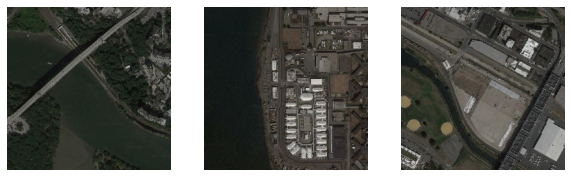

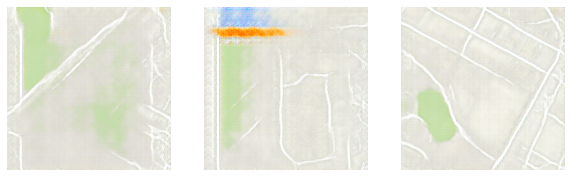

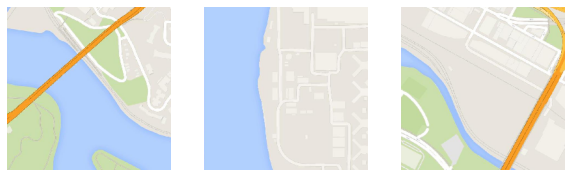

>52609, d1[0.000] d2[0.000] g[0.034]
>52610, d1[0.000] d2[0.000] g[0.052]
>52611, d1[0.000] d2[0.000] g[0.042]
>52612, d1[0.000] d2[0.000] g[0.043]
>52613, d1[0.000] d2[0.000] g[0.039]
>52614, d1[0.000] d2[0.000] g[0.023]
>52615, d1[0.000] d2[0.000] g[0.008]
>52616, d1[0.000] d2[0.000] g[0.041]
>52617, d1[0.000] d2[0.000] g[0.015]
>52618, d1[0.000] d2[0.000] g[0.023]
>52619, d1[0.000] d2[0.000] g[0.040]
>52620, d1[0.000] d2[0.000] g[0.065]
>52621, d1[0.000] d2[0.000] g[0.034]
>52622, d1[0.000] d2[0.000] g[0.047]
>52623, d1[0.000] d2[0.000] g[0.043]
>52624, d1[0.000] d2[0.000] g[0.037]
>52625, d1[0.000] d2[0.000] g[0.037]
>52626, d1[0.000] d2[0.000] g[0.037]
>52627, d1[0.000] d2[0.000] g[0.043]
>52628, d1[0.000] d2[0.000] g[0.044]
>52629, d1[0.000] d2[0.000] g[0.033]
>52630, d1[0.000] d2[0.000] g[0.024]
>52631, d1[0.000] d2[0.000] g[0.037]
>52632, d1[0.000] d2[0.000] g[0.035]
>52633, d1[0.000] d2[0.000] g[0.042]
>52634, d1[0.000] d2[0.000] g[0.046]
>52635, d1[0.000] d2[0.000] g[0.041]
>

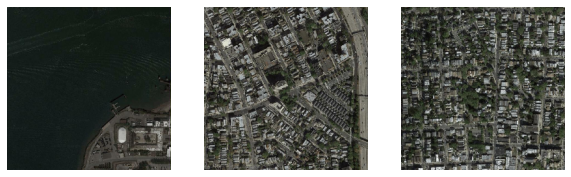

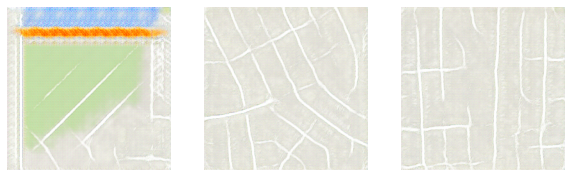

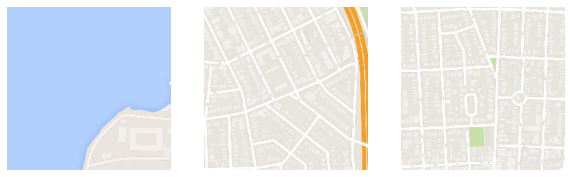

>53705, d1[0.000] d2[0.000] g[0.036]
>53706, d1[0.000] d2[0.000] g[0.043]
>53707, d1[0.000] d2[0.000] g[0.039]
>53708, d1[0.000] d2[0.000] g[0.053]
>53709, d1[0.000] d2[0.000] g[0.041]
>53710, d1[0.000] d2[0.000] g[0.025]
>53711, d1[0.000] d2[0.000] g[0.045]
>53712, d1[0.000] d2[0.000] g[0.046]
>53713, d1[0.000] d2[0.000] g[0.011]
>53714, d1[0.000] d2[0.000] g[0.042]
>53715, d1[0.000] d2[0.000] g[0.032]
>53716, d1[0.000] d2[0.000] g[0.014]
>53717, d1[0.000] d2[0.000] g[0.035]
>53718, d1[0.000] d2[0.000] g[0.028]
>53719, d1[0.000] d2[0.000] g[0.037]
>53720, d1[0.000] d2[0.000] g[0.039]
>53721, d1[0.000] d2[0.000] g[0.034]
>53722, d1[0.000] d2[0.000] g[0.020]
>53723, d1[0.000] d2[0.000] g[0.044]
>53724, d1[0.000] d2[0.000] g[0.046]
>53725, d1[0.000] d2[0.000] g[0.035]
>53726, d1[0.000] d2[0.000] g[0.034]
>53727, d1[0.000] d2[0.000] g[0.039]
>53728, d1[0.000] d2[0.000] g[0.011]
>53729, d1[0.000] d2[0.000] g[0.039]
>53730, d1[0.000] d2[0.000] g[0.035]
>53731, d1[0.000] d2[0.000] g[0.015]
>

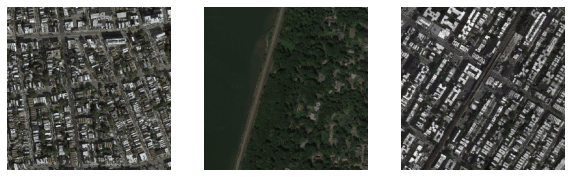

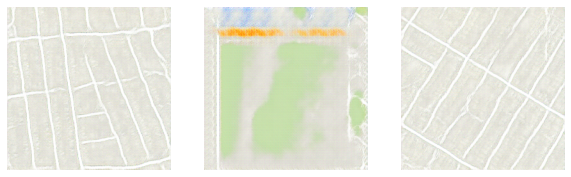

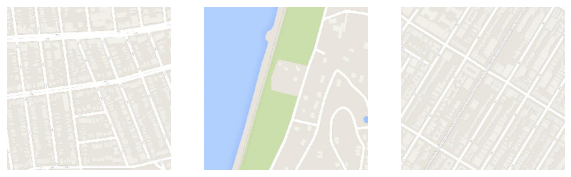

In [43]:
train(d_model, g_model,gan_model, dataset)

In [0]:
[X_realA, X_realB], y_realA = generate_real_samples(dataset, 1, 70)

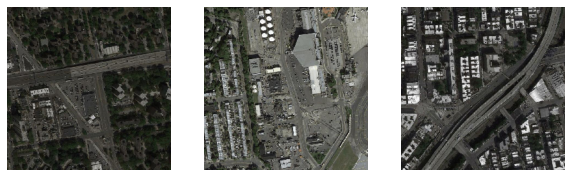

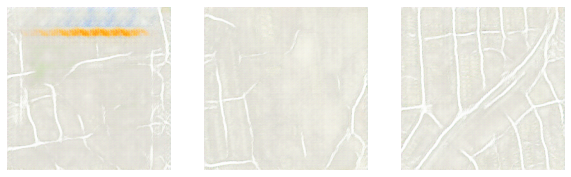

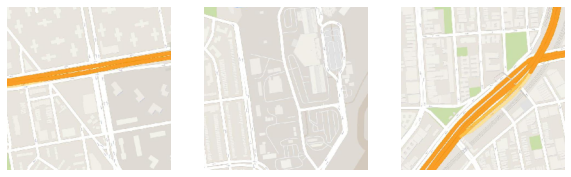

In [46]:
summarize_performance(dataset, g_model)